In [10]:
%load_ext autoreload
%autoreload 2

import logging
logging.basicConfig(format='%(message)s', level=logging.INFO)
import pickle

from ipywidgets import fixed, IntSlider, interact_manual

import pyro
pyro.enable_validation(True)
import pyro.distributions as dist
from pyro.infer import Predictive, TraceGraph_ELBO

from scipy.stats import norm

import torch
from torch.distributions import constraints
from torch import nn

from matplotlib import pyplot as plt

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [11]:
import sys
sys.path.append('./')

In [12]:
from src.visualization import (
    plot_ols,
    plot_single_prediction,
    plot_predictions,
    plot_mpd,
    make_interavtive
)
from src.utils import (
    make_ols,
    display_sourcecode,
    run_mcmc,
    sample_mcmc,
    summary,
    run_svi,
    SviPredictive,
    print_summary,
    sample_svi
)

In [13]:
with open('./data/linear-regression.pkl', 'rb') as f:
    data = pickle.load(f)
x_train = data['x_train']
y_train = data['y_train']
x_test = data['x_test']
y_test = data['y_test']

# Linear Regression with Ordinary Least Squares

Task: Predict log GDP per capita of a nation as a function of whether the nation is in Africa, and its Terrain Ruggedness Index.

$$ y_i = x_i^\intercal \beta + \epsilon_i $$

- What are the assumptions?
(Not obligatory)
   - Strict exogeneity - should have conditional mean zero:
   $$ \mathbb{E}[\epsilon_i | x_i] = 0 $$
   what implies $ \mathbb{E}[\epsilon_i] = 0 $, and that the regressors are uncorrelated with the errors
   - Constant variance (homoscedasticity) of $\epsilon_i$ across all values of the response (output) variable
   - No autocorrelation on errors - $ \mathbb{E}[\epsilon_i \epsilon_j | X] = 0 $ for $i \neq j$
   - Lack of perfect multicollinearity in the predictor variables - the matrix $X$ must have full column rank $p$
   - (Not needed for OLS but usefull to establish finite-sample properties) Normality of errors - $ \epsilon | X \sim \mathcal{N}(0, \sigma^2 \mathrm{I}_n) $
- Confidence and Prediction intervals
   1. Mean respons value
   $$ \hat{y}_i = x_i^\intercal \hat{\beta} $$
   We are interested in $\mathbb{E}[y_i | x_i]$.
   2. The actual respons value
   $$ \hat{y}_i = x_i^\intercal \hat{\beta} + \epsilon_i $$
   We are interested in $y_i | x_i$.
 
   - Confidence Intervals are for the mean respons (usually one looks at these)
   $$ \mathrm{Var}[\hat{y}_i] =  \mathrm{Var}[x_i^\intercal \hat{\beta}] = \sigma^2 x_i^\intercal \left( X^\intercal X \right)^{-1}x_i $$
   $$ \hat{y_i} \pm t_{n-p}^{\alpha / 2} \sigma \sqrt{x_i^\intercal \left( X^\intercal X \right)^{-1}x_i} $$ 
   
   - Prediction Intervals are for the actual respons (what we are interested in when considering uncertainty)
   $$ \mathrm{Var}[\hat{y}_i] = \mathrm{Var}[x_i^\intercal \hat{\beta} + \epsilon_i] = \mathrm{Var}[x_i^\intercal \hat{\beta} + (y_i -  x_i^\intercal \beta)] =  \mathrm{Var}[x_i^\intercal \hat{\beta} + y_i] = \sigma^2 \left(x_i^\intercal \left( X^\intercal X \right)^{-1}x_i + 1\right) $$
   $$ \hat{y_i} \pm t_{n-p}^{\alpha / 2} \sigma \sqrt{x_i^\intercal \left( X^\intercal X \right)^{-1}x_i + 1} $$

In [14]:
ols_train, ols_test, beta = make_ols(x_train, y_train, x_test)

In [15]:
beta

tensor([-0.1985,  0.1477,  0.1211,  0.0334,  0.0125,  0.1122,  0.5182,  0.1747])

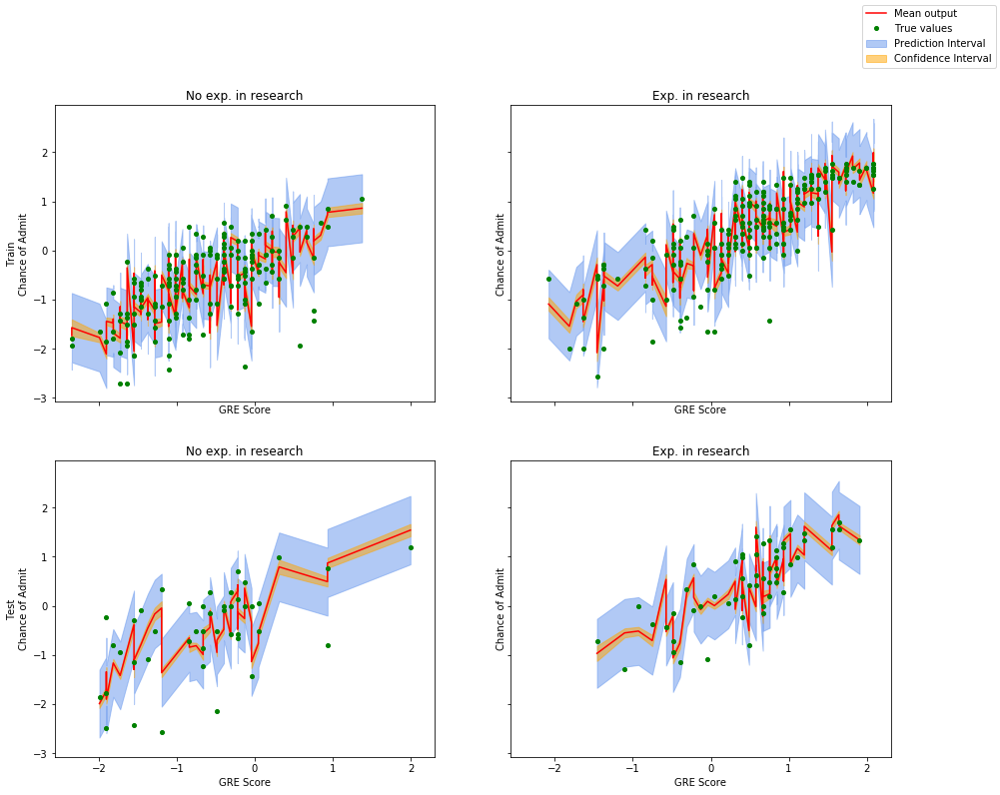

In [16]:
properties = {
    'x': 0,
    'x_label': "GRE Score",
    'y_label': "Chance of Admit",
    'category': 6,
    'category_labels': {
        0: "No exp. in research",
        1: "Exp. in research",
    }
}

data = {
    'Train': {
        'ols': ols_train,
        'x': x_train,
        'y': y_train
    },
    'Test': {
        'ols': ols_test,
        'x': x_test,
        'y': y_test
    }
}
   
plot_ols(data, properties)

# Bayesian Linear Regression

We formulate Bayesian linear regression using probability distributions rather than point estimates. The response, $y$, is not estimated as a single value, but is assumed to be drawn from a probability distribution. 

$$ y \sim \mathcal{N}(\beta^\intercal X, \sigma^2 \mathrm{I}) $$

The Bayesian analogy Confidence Intervals are [Credible Intervals](https://en.wikipedia.org/wiki/Credible_interval).

[Analytical solution](https://en.wikipedia.org/wiki/Bayesian_linear_regression#With_conjugate_priors)

# The Model
Can be initialized with estimate from OLS or with non-informative prior.

In [17]:
def model(x, y=None):
    print(x)
    intercept = pyro.sample("intercept", dist.Normal(beta[0], 10))
    b_GRE = pyro.sample("b_GRE", dist.Normal(beta[1], 1))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(beta[2], 1))
    b_university = pyro.sample("b_university", dist.Normal(beta[3], 1))
    b_SOP = pyro.sample("b_SOP", dist.Normal(beta[4], 1))
    b_LOP = pyro.sample("b_LOP", dist.Normal(beta[5], 1))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(beta[6], 1))
    b_research = pyro.sample("b_research", dist.Normal(beta[7], 1))

    sigma = pyro.sample("sigma", dist.Exponential(1))
    
    mean = (
            intercept +
            b_GRE * x[:, 0] +
            b_TEOFL * x[:, 1] +
            b_university * x[:, 2] +
            b_SOP * x[:, 3] +
            b_LOP * x[:, 4] +
            b_CGPA * x[:, 5] +
            b_research * x[:, 6]
    )
    with pyro.plate("data", x.shape[0]):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
    return mean

## Markov Chain Monte Carlo

In [18]:
from pyro.infer import NUTS, HMC

In [19]:
num_chains = 1
num_samples = 1_000

### Hamiltonian Monte Carlo

In [20]:
hmc_kernel = HMC(
    model=model,
    num_steps=20,
    step_size=1e-4,
    adapt_step_size=False,
)

hmc_mcmc_posterior = run_mcmc(
    kernel=hmc_kernel,
    model_args=(x_train, y_train),
    num_samples=num_samples,
    warmup_steps=None,
)

Warmup:   0%|                                                                                   | 0/2000 [00:00, ?it/s]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   0%|                                          | 2/2000 [00:01,  1.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   0%|                                          | 3/2000 [00:01,  1.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   0%|                                          | 4/2000 [00:01,  2.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   0%|                                          | 5/2000 [00:01,  2.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   0%|▏                                         | 7/2000 [00:02,  3.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   0%|▏                                         | 8/2000 [00:02,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   0%|▏                                         | 9/2000 [00:02,  4.91it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   0%|▏                                        | 10/2000 [00:02,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▏                                        | 11/2000 [00:02,  4.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▏                                        | 12/2000 [00:03,  4.39it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   1%|▎                                        | 13/2000 [00:03,  4.95it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▎                                        | 15/2000 [00:03,  6.22it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   1%|▎                                        | 16/2000 [00:03,  6.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▎                                        | 17/2000 [00:03,  6.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▎                                        | 18/2000 [00:03,  5.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▍                                        | 19/2000 [00:04,  4.89it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   1%|▍                                        | 20/2000 [00:04,  4.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▍                                        | 21/2000 [00:04,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▍                                        | 22/2000 [00:04,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▍                                        | 23/2000 [00:05,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▌                                        | 25/2000 [00:05,  5.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▌                                        | 26/2000 [00:05,  4.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▌                                        | 28/2000 [00:05,  5.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▌                                        | 30/2000 [00:06,  6.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▋                                        | 32/2000 [00:06,  7.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▋                                        | 34/2000 [00:06,  8.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▋                                        | 36/2000 [00:06,  9.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▊                                        | 38/2000 [00:06,  9.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▊                                        | 40/2000 [00:07, 10.10it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   2%|▊                                        | 42/2000 [00:07, 10.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▉                                        | 44/2000 [00:07, 10.93it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▉                                        | 46/2000 [00:07, 10.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▉                                        | 48/2000 [00:07,  9.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|█                                        | 50/2000 [00:08,  9.74it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   3%|█                                        | 52/2000 [00:08,  9.34it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   3%|█                                        | 53/2000 [00:08,  9.25it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   3%|█▏                                       | 55/2000 [00:08,  8.38it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   3%|█▏                                       | 56/2000 [00:08,  8.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▏                                       | 58/2000 [00:08,  8.74it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▏                                       | 60/2000 [00:09,  9.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▎                                       | 62/2000 [00:09,  9.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▎                                       | 63/2000 [00:09,  9.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▎                                       | 65/2000 [00:09,  9.63it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   3%|█▎                                       | 66/2000 [00:09,  9.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▍                                       | 68/2000 [00:09,  9.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▍                                       | 70/2000 [00:10,  9.97it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   4%|█▍                                       | 73/2000 [00:10,  9.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▌                                       | 74/2000 [00:10,  9.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▌                                       | 76/2000 [00:10,  9.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▌                                       | 78/2000 [00:11,  9.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▋                                       | 80/2000 [00:11,  9.14it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   4%|█▋                                       | 82/2000 [00:11,  9.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▋                                       | 83/2000 [00:11,  9.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▋                                       | 85/2000 [00:11,  9.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▊                                       | 87/2000 [00:11,  9.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▊                                       | 89/2000 [00:12,  9.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|█▊                                       | 91/2000 [00:12, 10.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|█▉                                       | 93/2000 [00:12, 10.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|█▉                                       | 95/2000 [00:12,  9.93it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   5%|█▉                                       | 97/2000 [00:12, 10.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██                                       | 99/2000 [00:13, 10.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██                                      | 101/2000 [00:13, 10.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██                                      | 103/2000 [00:13, 11.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██                                      | 105/2000 [00:13, 10.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██▏                                     | 107/2000 [00:14,  5.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██▏                                     | 108/2000 [00:14,  3.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██▏                                     | 109/2000 [00:15,  2.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▏                                     | 110/2000 [00:15,  2.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:   6%|██▏                                     | 111/2000 [00:16,  2.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▏                                     | 112/2000 [00:16,  2.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▎                                     | 113/2000 [00:17,  2.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▎                                     | 114/2000 [00:17,  2.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▎                                     | 116/2000 [00:17,  3.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▎                                     | 118/2000 [00:17,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▍                                     | 120/2000 [00:17,  5.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▍                                     | 122/2000 [00:18,  6.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▌                                     | 126/2000 [00:18,  8.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▌                                     | 128/2000 [00:18,  6.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▌                                     | 129/2000 [00:19,  5.61it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   6%|██▌                                     | 130/2000 [00:19,  5.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▌                                     | 131/2000 [00:19,  4.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 132/2000 [00:19,  4.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 133/2000 [00:20,  4.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 134/2000 [00:20,  4.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 135/2000 [00:20,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 136/2000 [00:20,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 137/2000 [00:20,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▊                                     | 138/2000 [00:21,  4.50it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   7%|██▊                                     | 139/2000 [00:21,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▊                                     | 140/2000 [00:21,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▊                                     | 141/2000 [00:21,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▊                                     | 142/2000 [00:22,  4.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▊                                     | 143/2000 [00:22,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 144/2000 [00:22,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 145/2000 [00:22,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 146/2000 [00:23,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 147/2000 [00:23,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 148/2000 [00:23,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 149/2000 [00:23,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 150/2000 [00:23,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 151/2000 [00:24,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 152/2000 [00:24,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 153/2000 [00:24,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 154/2000 [00:24,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 155/2000 [00:25,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 156/2000 [00:25,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 157/2000 [00:25,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 158/2000 [00:25,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 159/2000 [00:26,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 160/2000 [00:26,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 161/2000 [00:26,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 162/2000 [00:26,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▎                                    | 164/2000 [00:27,  5.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▎                                    | 165/2000 [00:27,  4.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▎                                    | 166/2000 [00:27,  4.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▎                                    | 167/2000 [00:27,  4.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▎                                    | 168/2000 [00:27,  4.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▍                                    | 169/2000 [00:28,  4.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▍                                    | 170/2000 [00:28,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▍                                    | 171/2000 [00:28,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▍                                    | 172/2000 [00:28,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▍                                    | 173/2000 [00:29,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▍                                    | 174/2000 [00:29,  4.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 175/2000 [00:29,  4.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 176/2000 [00:29,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 177/2000 [00:29,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 178/2000 [00:30,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 179/2000 [00:30,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 180/2000 [00:30,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 181/2000 [00:30,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▋                                    | 182/2000 [00:31,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▋                                    | 183/2000 [00:31,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▋                                    | 184/2000 [00:31,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▋                                    | 185/2000 [00:31,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▋                                    | 186/2000 [00:32,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▋                                    | 187/2000 [00:32,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▊                                    | 188/2000 [00:32,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▊                                    | 189/2000 [00:32,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|███▊                                    | 190/2000 [00:33,  4.25it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  10%|███▊                                    | 192/2000 [00:33,  5.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|███▊                                    | 193/2000 [00:33,  6.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|███▉                                    | 194/2000 [00:33,  5.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|███▉                                    | 195/2000 [00:33,  5.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|███▉                                    | 196/2000 [00:34,  4.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|███▉                                    | 197/2000 [00:34,  4.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|███▉                                    | 198/2000 [00:34,  4.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|███▉                                    | 199/2000 [00:34,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████                                    | 200/2000 [00:34,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████                                    | 201/2000 [00:35,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████                                    | 202/2000 [00:35,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████                                    | 203/2000 [00:35,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████                                    | 204/2000 [00:35,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████                                    | 205/2000 [00:36,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████                                    | 206/2000 [00:36,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████▏                                   | 207/2000 [00:36,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████▏                                   | 208/2000 [00:36,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████▏                                   | 209/2000 [00:37,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  10%|████▏                                   | 210/2000 [00:37,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▏                                   | 211/2000 [00:37,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▏                                   | 212/2000 [00:37,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▎                                   | 213/2000 [00:38,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▎                                   | 214/2000 [00:38,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▎                                   | 215/2000 [00:38,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▎                                   | 216/2000 [00:38,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▎                                   | 217/2000 [00:38,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▎                                   | 218/2000 [00:39,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▍                                   | 219/2000 [00:39,  4.30it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  11%|████▍                                   | 220/2000 [00:39,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▍                                   | 221/2000 [00:39,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▍                                   | 222/2000 [00:40,  4.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▍                                   | 224/2000 [00:40,  6.03it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▌                                   | 225/2000 [00:40,  6.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▌                                   | 226/2000 [00:40,  5.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▌                                   | 227/2000 [00:40,  4.86it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  11%|████▌                                   | 228/2000 [00:41,  4.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  11%|████▌                                   | 229/2000 [00:41,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▌                                   | 230/2000 [00:41,  4.57it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  12%|████▌                                   | 231/2000 [00:41,  4.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▋                                   | 232/2000 [00:42,  4.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▋                                   | 234/2000 [00:42,  5.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▋                                   | 236/2000 [00:42,  6.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▊                                   | 238/2000 [00:42,  7.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▊                                   | 240/2000 [00:42,  8.36it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  12%|████▊                                   | 241/2000 [00:42,  7.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▊                                   | 242/2000 [00:43,  6.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▊                                   | 243/2000 [00:43,  5.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▉                                   | 244/2000 [00:43,  6.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▉                                   | 245/2000 [00:43,  5.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▉                                   | 246/2000 [00:43,  5.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▉                                   | 247/2000 [00:44,  4.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▉                                   | 248/2000 [00:44,  4.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|████▉                                   | 249/2000 [00:44,  4.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  12%|█████                                   | 250/2000 [00:44,  5.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████                                   | 251/2000 [00:44,  6.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████                                   | 253/2000 [00:45,  6.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████                                   | 254/2000 [00:45,  6.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████                                   | 255/2000 [00:45,  5.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████                                   | 256/2000 [00:45,  4.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▏                                  | 257/2000 [00:46,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▏                                  | 258/2000 [00:46,  4.12it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▏                                  | 259/2000 [00:46,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▏                                  | 260/2000 [00:46,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▏                                  | 261/2000 [00:47,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▏                                  | 262/2000 [00:47,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▎                                  | 263/2000 [00:47,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▎                                  | 264/2000 [00:47,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▎                                  | 265/2000 [00:48,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▎                                  | 266/2000 [00:48,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▎                                  | 267/2000 [00:48,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▎                                  | 268/2000 [00:48,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  13%|█████▍                                  | 269/2000 [00:48,  4.74it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▍                                  | 270/2000 [00:49,  4.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▍                                  | 271/2000 [00:49,  4.64it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  14%|█████▍                                  | 272/2000 [00:49,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▍                                  | 273/2000 [00:49,  4.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▍                                  | 274/2000 [00:49,  4.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▌                                  | 275/2000 [00:50,  4.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▌                                  | 276/2000 [00:50,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▌                                  | 277/2000 [00:50,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▌                                  | 278/2000 [00:50,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▌                                  | 279/2000 [00:51,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▌                                  | 280/2000 [00:51,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▌                                  | 281/2000 [00:51,  4.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▋                                  | 282/2000 [00:51,  4.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▋                                  | 283/2000 [00:51,  4.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▋                                  | 284/2000 [00:52,  4.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▋                                  | 285/2000 [00:52,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▋                                  | 287/2000 [00:52,  4.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▊                                  | 288/2000 [00:53,  4.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▊                                  | 289/2000 [00:53,  5.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  14%|█████▊                                  | 290/2000 [00:53,  4.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|█████▊                                  | 291/2000 [00:53,  4.30it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  15%|█████▊                                  | 292/2000 [00:53,  4.68it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  15%|█████▊                                  | 293/2000 [00:54,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|█████▉                                  | 294/2000 [00:54,  3.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|█████▉                                  | 296/2000 [00:54,  4.37it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  15%|█████▉                                  | 297/2000 [00:55,  4.46it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  15%|█████▉                                  | 299/2000 [00:55,  5.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████                                  | 300/2000 [00:55,  5.02it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  15%|██████                                  | 301/2000 [00:55,  4.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████                                  | 302/2000 [00:56,  4.85it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████                                  | 303/2000 [00:56,  4.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████                                  | 304/2000 [00:56,  4.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████                                  | 305/2000 [00:56,  4.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████                                  | 306/2000 [00:57,  4.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████▏                                 | 307/2000 [00:57,  5.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████▏                                 | 308/2000 [00:57,  4.85it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  15%|██████▏                                 | 309/2000 [00:57,  4.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▏                                 | 310/2000 [00:57,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▏                                 | 311/2000 [00:58,  4.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▏                                 | 312/2000 [00:58,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▎                                 | 313/2000 [00:58,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▎                                 | 314/2000 [00:58,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▎                                 | 315/2000 [00:59,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▎                                 | 316/2000 [00:59,  4.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▎                                 | 317/2000 [00:59,  5.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▎                                 | 318/2000 [00:59,  5.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▍                                 | 319/2000 [00:59,  4.98it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▍                                 | 321/2000 [01:00,  5.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▍                                 | 322/2000 [01:00,  5.56it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  16%|██████▍                                 | 323/2000 [01:00,  5.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▍                                 | 324/2000 [01:00,  5.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▌                                 | 325/2000 [01:00,  5.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▌                                 | 326/2000 [01:01,  5.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▌                                 | 327/2000 [01:01,  5.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▌                                 | 328/2000 [01:01,  4.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▌                                 | 329/2000 [01:01,  4.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  16%|██████▌                                 | 330/2000 [01:01,  4.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▌                                 | 331/2000 [01:02,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▋                                 | 332/2000 [01:02,  4.38it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  17%|██████▋                                 | 333/2000 [01:02,  4.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▋                                 | 334/2000 [01:02,  5.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▋                                 | 335/2000 [01:02,  4.74it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▋                                 | 336/2000 [01:03,  5.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▋                                 | 337/2000 [01:03,  5.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▊                                 | 338/2000 [01:03,  4.71it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▊                                 | 339/2000 [01:03,  4.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▊                                 | 340/2000 [01:04,  4.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▊                                 | 342/2000 [01:04,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▊                                 | 343/2000 [01:04,  4.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▉                                 | 345/2000 [01:05,  5.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▉                                 | 346/2000 [01:05,  4.78it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  17%|██████▉                                 | 347/2000 [01:05,  4.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▉                                 | 348/2000 [01:05,  5.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  17%|██████▉                                 | 349/2000 [01:05,  5.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████                                 | 350/2000 [01:06,  4.85it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████                                 | 351/2000 [01:06,  4.71it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████                                 | 352/2000 [01:06,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████                                 | 353/2000 [01:06,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████                                 | 354/2000 [01:07,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████                                 | 355/2000 [01:07,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████                                 | 356/2000 [01:07,  5.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▏                                | 358/2000 [01:07,  5.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▏                                | 359/2000 [01:07,  6.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▏                                | 360/2000 [01:07,  5.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▏                                | 361/2000 [01:08,  5.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▏                                | 362/2000 [01:08,  5.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▎                                | 363/2000 [01:08,  4.95it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▎                                | 364/2000 [01:08,  4.71it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  18%|███████▎                                | 365/2000 [01:09,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▎                                | 366/2000 [01:09,  4.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▎                                | 367/2000 [01:09,  4.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  18%|███████▎                                | 368/2000 [01:09,  4.68it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  18%|███████▍                                | 369/2000 [01:09,  5.02it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  18%|███████▍                                | 370/2000 [01:10,  4.95it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▍                                | 371/2000 [01:10,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▍                                | 372/2000 [01:10,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▍                                | 373/2000 [01:10,  4.19it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  19%|███████▍                                | 374/2000 [01:11,  3.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▌                                | 375/2000 [01:11,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▌                                | 376/2000 [01:11,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▌                                | 377/2000 [01:11,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▌                                | 378/2000 [01:12,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▌                                | 379/2000 [01:12,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▌                                | 380/2000 [01:12,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▌                                | 381/2000 [01:12,  4.81it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  19%|███████▋                                | 382/2000 [01:12,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▋                                | 383/2000 [01:13,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▋                                | 384/2000 [01:13,  3.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▋                                | 385/2000 [01:14,  2.93it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▋                                | 386/2000 [01:14,  3.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▋                                | 387/2000 [01:14,  3.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▊                                | 388/2000 [01:14,  3.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  19%|███████▊                                | 389/2000 [01:14,  4.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▊                                | 390/2000 [01:15,  4.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▊                                | 391/2000 [01:15,  4.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▊                                | 392/2000 [01:15,  4.85it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  20%|███████▊                                | 393/2000 [01:15,  4.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▉                                | 394/2000 [01:15,  4.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▉                                | 395/2000 [01:16,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▉                                | 396/2000 [01:16,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▉                                | 397/2000 [01:16,  4.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▉                                | 398/2000 [01:16,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|███████▉                                | 399/2000 [01:17,  4.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████                                | 400/2000 [01:17,  4.04it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  20%|████████                                | 401/2000 [01:17,  4.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████                                | 402/2000 [01:17,  3.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████                                | 403/2000 [01:18,  3.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████                                | 404/2000 [01:18,  3.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████                                | 405/2000 [01:18,  3.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████                                | 406/2000 [01:19,  3.71it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████▏                               | 407/2000 [01:19,  3.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████▏                               | 408/2000 [01:19,  3.92it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  20%|████████▏                               | 409/2000 [01:19,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  20%|████████▏                               | 410/2000 [01:20,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▏                               | 411/2000 [01:20,  4.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▏                               | 412/2000 [01:20,  4.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▎                               | 414/2000 [01:20,  4.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:  21%|████████▎                               | 415/2000 [01:21,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▎                               | 416/2000 [01:21,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▎                               | 417/2000 [01:21,  3.87it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  21%|████████▎                               | 418/2000 [01:21,  3.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▍                               | 419/2000 [01:22,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▍                               | 420/2000 [01:22,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▍                               | 421/2000 [01:22,  4.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▍                               | 422/2000 [01:22,  4.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▍                               | 423/2000 [01:23,  4.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▍                               | 424/2000 [01:23,  3.93it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▌                               | 426/2000 [01:23,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▌                               | 427/2000 [01:24,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▌                               | 428/2000 [01:24,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  21%|████████▌                               | 429/2000 [01:24,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▌                               | 430/2000 [01:24,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▌                               | 431/2000 [01:25,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▋                               | 432/2000 [01:25,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▋                               | 433/2000 [01:25,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▋                               | 434/2000 [01:25,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▋                               | 435/2000 [01:25,  5.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▋                               | 436/2000 [01:26,  4.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▋                               | 437/2000 [01:26,  4.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▊                               | 438/2000 [01:26,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▊                               | 439/2000 [01:26,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▊                               | 440/2000 [01:26,  4.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▊                               | 441/2000 [01:27,  4.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▊                               | 442/2000 [01:27,  4.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▊                               | 443/2000 [01:27,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▉                               | 444/2000 [01:27,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▉                               | 445/2000 [01:28,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▉                               | 446/2000 [01:28,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▉                               | 447/2000 [01:28,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▉                               | 448/2000 [01:28,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|████████▉                               | 449/2000 [01:29,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  22%|█████████                               | 450/2000 [01:29,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████                               | 451/2000 [01:29,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████                               | 452/2000 [01:29,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████                               | 453/2000 [01:29,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████                               | 454/2000 [01:30,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████                               | 455/2000 [01:30,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████                               | 456/2000 [01:30,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▏                              | 457/2000 [01:30,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▏                              | 458/2000 [01:31,  4.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▏                              | 459/2000 [01:31,  4.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▏                              | 460/2000 [01:31,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▏                              | 461/2000 [01:31,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▏                              | 462/2000 [01:32,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▎                              | 463/2000 [01:32,  4.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▎                              | 464/2000 [01:32,  4.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▎                              | 465/2000 [01:32,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▎                              | 467/2000 [01:33,  4.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▎                              | 468/2000 [01:33,  4.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  23%|█████████▍                              | 469/2000 [01:33,  4.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▍                              | 470/2000 [01:33,  4.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▍                              | 471/2000 [01:33,  4.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▍                              | 472/2000 [01:34,  4.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▍                              | 473/2000 [01:34,  4.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▍                              | 474/2000 [01:34,  4.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▌                              | 475/2000 [01:34,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▌                              | 477/2000 [01:35,  4.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▌                              | 478/2000 [01:35,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▌                              | 479/2000 [01:35,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▌                              | 480/2000 [01:35,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▌                              | 481/2000 [01:36,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▋                              | 482/2000 [01:36,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▋                              | 483/2000 [01:36,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▋                              | 484/2000 [01:36,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▋                              | 485/2000 [01:37,  4.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▋                              | 486/2000 [01:37,  4.50it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  24%|█████████▋                              | 487/2000 [01:37,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▊                              | 488/2000 [01:37,  3.99it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  24%|█████████▊                              | 489/2000 [01:38,  4.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  24%|█████████▊                              | 490/2000 [01:38,  4.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|█████████▊                              | 491/2000 [01:38,  4.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|█████████▊                              | 492/2000 [01:38,  4.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|█████████▊                              | 493/2000 [01:39,  4.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|█████████▉                              | 494/2000 [01:39,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|█████████▉                              | 495/2000 [01:39,  4.71it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|█████████▉                              | 496/2000 [01:39,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|█████████▉                              | 497/2000 [01:39,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|█████████▉                              | 498/2000 [01:40,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████                              | 500/2000 [01:40,  4.85it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████                              | 501/2000 [01:40,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████                              | 502/2000 [01:41,  4.31it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  25%|██████████                              | 503/2000 [01:41,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████                              | 504/2000 [01:41,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████                              | 505/2000 [01:41,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████                              | 506/2000 [01:41,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████▏                             | 507/2000 [01:42,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████▏                             | 508/2000 [01:42,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  25%|██████████▏                             | 509/2000 [01:42,  4.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▏                             | 510/2000 [01:42,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▏                             | 511/2000 [01:43,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▏                             | 512/2000 [01:43,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▎                             | 513/2000 [01:43,  4.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▎                             | 514/2000 [01:43,  4.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▎                             | 515/2000 [01:44,  4.03it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▎                             | 516/2000 [01:44,  4.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▎                             | 517/2000 [01:44,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▎                             | 518/2000 [01:44,  4.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▍                             | 519/2000 [01:45,  4.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▍                             | 520/2000 [01:45,  4.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▍                             | 521/2000 [01:45,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▍                             | 522/2000 [01:45,  4.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▍                             | 523/2000 [01:46,  3.77it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  26%|██████████▍                             | 524/2000 [01:46,  3.71it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  26%|██████████▌                             | 525/2000 [01:46,  4.02it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▌                             | 526/2000 [01:46,  4.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▌                             | 527/2000 [01:47,  3.84it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  26%|██████████▌                             | 528/2000 [01:47,  3.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  26%|██████████▌                             | 529/2000 [01:47,  3.97it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  26%|██████████▌                             | 530/2000 [01:47,  3.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▌                             | 531/2000 [01:48,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▋                             | 532/2000 [01:48,  4.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▋                             | 534/2000 [01:48,  4.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▋                             | 535/2000 [01:48,  4.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▋                             | 536/2000 [01:49,  4.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▋                             | 537/2000 [01:49,  3.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▊                             | 538/2000 [01:49,  3.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▊                             | 539/2000 [01:50,  3.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▊                             | 540/2000 [01:50,  3.43it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  27%|██████████▊                             | 541/2000 [01:50,  3.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▊                             | 542/2000 [01:50,  3.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▊                             | 543/2000 [01:51,  3.59it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  27%|██████████▉                             | 544/2000 [01:51,  3.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▉                             | 545/2000 [01:51,  3.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▉                             | 546/2000 [01:52,  3.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▉                             | 547/2000 [01:52,  3.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  27%|██████████▉                             | 548/2000 [01:52,  3.25it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  27%|██████████▉                             | 549/2000 [01:53,  2.73it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████                             | 550/2000 [01:53,  2.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████                             | 551/2000 [01:53,  3.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████                             | 552/2000 [01:54,  3.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████                             | 554/2000 [01:54,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████                             | 555/2000 [01:54,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████                             | 556/2000 [01:54,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▏                            | 557/2000 [01:55,  4.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▏                            | 558/2000 [01:55,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▏                            | 559/2000 [01:55,  4.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▏                            | 560/2000 [01:55,  4.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▏                            | 562/2000 [01:55,  6.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▎                            | 563/2000 [01:56,  6.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▎                            | 564/2000 [01:56,  5.87it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▎                            | 565/2000 [01:56,  5.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▎                            | 566/2000 [01:56,  5.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▎                            | 567/2000 [01:56,  4.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▎                            | 568/2000 [01:57,  4.85it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▍                            | 569/2000 [01:57,  4.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  28%|███████████▍                            | 570/2000 [01:57,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▍                            | 571/2000 [01:57,  4.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▍                            | 572/2000 [01:57,  4.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▍                            | 574/2000 [01:58,  6.31it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  29%|███████████▌                            | 575/2000 [01:58,  6.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▌                            | 577/2000 [01:58,  7.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▌                            | 579/2000 [01:58,  7.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▌                            | 580/2000 [01:59,  5.92it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▌                            | 581/2000 [01:59,  5.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▋                            | 582/2000 [01:59,  4.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▋                            | 583/2000 [01:59,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▋                            | 585/2000 [02:00,  4.71it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▋                            | 587/2000 [02:00,  5.11it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▊                            | 588/2000 [02:00,  4.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  29%|███████████▊                            | 589/2000 [02:00,  4.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▊                            | 590/2000 [02:01,  4.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▊                            | 591/2000 [02:01,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▊                            | 592/2000 [02:01,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▊                            | 593/2000 [02:01,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▉                            | 594/2000 [02:02,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▉                            | 595/2000 [02:02,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▉                            | 596/2000 [02:02,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▉                            | 597/2000 [02:02,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|███████████▉                            | 599/2000 [02:03,  5.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|████████████                            | 601/2000 [02:03,  5.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|████████████                            | 602/2000 [02:03,  5.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|████████████                            | 603/2000 [02:03,  5.39it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  30%|████████████                            | 604/2000 [02:04,  5.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|████████████                            | 605/2000 [02:04,  4.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|████████████                            | 606/2000 [02:04,  4.49it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  30%|████████████▏                           | 607/2000 [02:04,  4.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|████████████▏                           | 608/2000 [02:05,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|████████████▏                           | 609/2000 [02:05,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  30%|████████████▏                           | 610/2000 [02:05,  4.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▏                           | 611/2000 [02:05,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▏                           | 612/2000 [02:05,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▎                           | 613/2000 [02:06,  4.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▎                           | 614/2000 [02:06,  4.81it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  31%|████████████▎                           | 615/2000 [02:06,  4.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▎                           | 616/2000 [02:06,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▎                           | 617/2000 [02:07,  4.38it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  31%|████████████▎                           | 618/2000 [02:07,  4.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▍                           | 619/2000 [02:07,  4.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▍                           | 620/2000 [02:07,  4.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▍                           | 621/2000 [02:07,  4.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▍                           | 622/2000 [02:08,  4.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▍                           | 623/2000 [02:08,  4.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▍                           | 624/2000 [02:08,  4.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▌                           | 625/2000 [02:08,  4.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▌                           | 626/2000 [02:09,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▌                           | 628/2000 [02:09,  4.77it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  31%|████████████▌                           | 629/2000 [02:09,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▌                           | 630/2000 [02:09,  4.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▌                           | 631/2000 [02:10,  4.03it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▋                           | 632/2000 [02:10,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▋                           | 633/2000 [02:10,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▋                           | 634/2000 [02:10,  4.14it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  32%|████████████▋                           | 635/2000 [02:11,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▋                           | 636/2000 [02:11,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▋                           | 637/2000 [02:11,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▊                           | 638/2000 [02:11,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▊                           | 639/2000 [02:12,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▊                           | 640/2000 [02:12,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▊                           | 641/2000 [02:12,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▊                           | 642/2000 [02:12,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▊                           | 643/2000 [02:13,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▉                           | 644/2000 [02:13,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▉                           | 645/2000 [02:13,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▉                           | 646/2000 [02:13,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▉                           | 647/2000 [02:13,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▉                           | 648/2000 [02:14,  4.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|████████████▉                           | 649/2000 [02:14,  4.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  32%|█████████████                           | 650/2000 [02:14,  4.19it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  33%|█████████████                           | 651/2000 [02:14,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████                           | 652/2000 [02:15,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████                           | 653/2000 [02:15,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████                           | 654/2000 [02:15,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████                           | 655/2000 [02:15,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████                           | 656/2000 [02:16,  4.30it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  33%|█████████████▏                          | 657/2000 [02:16,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▏                          | 658/2000 [02:16,  5.09it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  33%|█████████████▏                          | 659/2000 [02:16,  4.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▏                          | 660/2000 [02:16,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▏                          | 661/2000 [02:17,  4.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▏                          | 662/2000 [02:17,  4.44it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  33%|█████████████▎                          | 663/2000 [02:17,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▎                          | 664/2000 [02:17,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▎                          | 665/2000 [02:18,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▎                          | 667/2000 [02:18,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▎                          | 668/2000 [02:18,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  33%|█████████████▍                          | 669/2000 [02:18,  4.37it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  34%|█████████████▍                          | 670/2000 [02:19,  4.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▍                          | 671/2000 [02:19,  4.13it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  34%|█████████████▍                          | 672/2000 [02:19,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:  34%|█████████████▍                          | 673/2000 [02:19,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▍                          | 674/2000 [02:20,  3.92it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▌                          | 675/2000 [02:20,  3.71it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  34%|█████████████▌                          | 676/2000 [02:20,  4.06it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▌                          | 677/2000 [02:21,  3.77it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▌                          | 678/2000 [02:21,  3.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▌                          | 679/2000 [02:21,  3.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▌                          | 680/2000 [02:21,  3.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▌                          | 681/2000 [02:22,  3.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▋                          | 682/2000 [02:22,  3.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▋                          | 683/2000 [02:22,  3.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▋                          | 684/2000 [02:22,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▋                          | 685/2000 [02:23,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▋                          | 686/2000 [02:23,  4.27it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  34%|█████████████▋                          | 687/2000 [02:23,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▊                          | 688/2000 [02:23,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▊                          | 689/2000 [02:24,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  34%|█████████████▊                          | 690/2000 [02:24,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|█████████████▊                          | 691/2000 [02:24,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|█████████████▊                          | 692/2000 [02:24,  4.26it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  35%|█████████████▊                          | 693/2000 [02:24,  4.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|█████████████▉                          | 695/2000 [02:25,  5.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|█████████████▉                          | 696/2000 [02:25,  5.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|█████████████▉                          | 697/2000 [02:25,  4.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|█████████████▉                          | 698/2000 [02:25,  4.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|█████████████▉                          | 699/2000 [02:26,  4.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████                          | 700/2000 [02:26,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████                          | 701/2000 [02:26,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████                          | 702/2000 [02:26,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████                          | 703/2000 [02:27,  4.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████                          | 704/2000 [02:27,  4.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████                          | 705/2000 [02:27,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████                          | 706/2000 [02:27,  4.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████▏                         | 707/2000 [02:27,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████▏                         | 708/2000 [02:28,  3.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  35%|██████████████▏                         | 709/2000 [02:28,  3.52it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  36%|██████████████▏                         | 710/2000 [02:28,  3.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▏                         | 711/2000 [02:29,  3.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▏                         | 712/2000 [02:29,  3.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▎                         | 713/2000 [02:29,  3.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▎                         | 714/2000 [02:29,  3.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▎                         | 716/2000 [02:30,  4.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▎                         | 717/2000 [02:30,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▎                         | 718/2000 [02:30,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▍                         | 719/2000 [02:31,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▍                         | 720/2000 [02:31,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▍                         | 721/2000 [02:31,  4.24it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  36%|██████████████▍                         | 722/2000 [02:31,  4.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▍                         | 723/2000 [02:32,  4.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▍                         | 724/2000 [02:32,  4.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▌                         | 726/2000 [02:32,  5.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▌                         | 728/2000 [02:32,  5.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  36%|██████████████▌                         | 729/2000 [02:32,  6.11it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  37%|██████████████▌                         | 731/2000 [02:33,  7.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  37%|██████████████▋                         | 732/2000 [02:33,  7.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  37%|██████████████▋                         | 734/2000 [02:33,  8.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  37%|██████████████▋                         | 736/2000 [02:33,  9.06it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  37%|██████████████▊                         | 738/2000 [02:33,  9.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  37%|██████████████▊                         | 740/2000 [02:34, 10.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  37%|██████████████▊                         | 742/2000 [02:34, 10.38it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  37%|██████████████▉                         | 744/2000 [02:34, 10.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  37%|██████████████▉                         | 748/2000 [02:34, 11.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████                         | 750/2000 [02:34, 11.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████                         | 752/2000 [02:35, 11.33it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  38%|███████████████                         | 754/2000 [02:35, 11.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████                         | 756/2000 [02:35, 11.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████▏                        | 758/2000 [02:35, 11.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████▏                        | 760/2000 [02:35, 11.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████▏                        | 762/2000 [02:35, 11.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████▎                        | 764/2000 [02:36, 11.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████▎                        | 766/2000 [02:36, 11.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  38%|███████████████▍                        | 770/2000 [02:36, 11.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  39%|███████████████▍                        | 772/2000 [02:36, 11.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  39%|███████████████▍                        | 774/2000 [02:36, 11.92it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  39%|███████████████▌                        | 776/2000 [02:37, 11.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  39%|███████████████▌                        | 778/2000 [02:37, 11.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  39%|███████████████▌                        | 780/2000 [02:37, 11.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  39%|███████████████▋                        | 782/2000 [02:37, 11.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  39%|███████████████▋                        | 784/2000 [02:37, 11.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  39%|███████████████▋                        | 786/2000 [02:38, 11.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|███████████████▊                        | 790/2000 [02:38, 11.98it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|███████████████▊                        | 792/2000 [02:38, 12.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|███████████████▉                        | 794/2000 [02:38, 12.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|███████████████▉                        | 796/2000 [02:38, 12.08it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|███████████████▉                        | 798/2000 [02:39, 12.10it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  40%|████████████████                        | 800/2000 [02:39, 12.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|████████████████                        | 802/2000 [02:39, 11.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|████████████████                        | 804/2000 [02:39, 11.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|████████████████                        | 806/2000 [02:39, 11.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  40%|████████████████▏                       | 810/2000 [02:40, 11.92it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▏                       | 812/2000 [02:40, 11.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▎                       | 814/2000 [02:40, 11.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▎                       | 816/2000 [02:40, 11.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▎                       | 818/2000 [02:40, 11.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▍                       | 820/2000 [02:40, 11.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▍                       | 822/2000 [02:41, 11.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▍                       | 824/2000 [02:41, 11.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▌                       | 826/2000 [02:41, 11.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  41%|████████████████▌                       | 828/2000 [02:41, 11.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▌                       | 830/2000 [02:41, 11.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▋                       | 832/2000 [02:41, 11.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▋                       | 834/2000 [02:42, 11.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▊                       | 838/2000 [02:42, 11.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▊                       | 840/2000 [02:42, 11.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▊                       | 842/2000 [02:42, 11.98it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▉                       | 844/2000 [02:42, 12.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▉                       | 846/2000 [02:43, 12.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|████████████████▉                       | 848/2000 [02:43, 12.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  42%|█████████████████                       | 850/2000 [02:43, 12.08it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  43%|█████████████████                       | 854/2000 [02:43, 12.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  43%|█████████████████                       | 856/2000 [02:43, 11.95it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  43%|█████████████████▏                      | 858/2000 [02:44, 11.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  43%|█████████████████▏                      | 860/2000 [02:44, 11.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  43%|█████████████████▏                      | 862/2000 [02:44, 11.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  43%|█████████████████▎                      | 864/2000 [02:44, 11.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  43%|█████████████████▎                      | 866/2000 [02:44, 11.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  43%|█████████████████▎                      | 868/2000 [02:45, 11.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▍                      | 870/2000 [02:45, 11.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▍                      | 872/2000 [02:45, 11.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▍                      | 874/2000 [02:45, 11.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▌                      | 876/2000 [02:45, 11.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▌                      | 878/2000 [02:45, 11.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▋                      | 882/2000 [02:46, 11.57it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  44%|█████████████████▋                      | 884/2000 [02:46, 11.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▋                      | 886/2000 [02:46, 11.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▊                      | 888/2000 [02:46, 11.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  44%|█████████████████▊                      | 890/2000 [02:46, 10.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|█████████████████▊                      | 892/2000 [02:47, 11.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|█████████████████▉                      | 894/2000 [02:47, 11.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|█████████████████▉                      | 896/2000 [02:47, 11.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|█████████████████▉                      | 898/2000 [02:47, 11.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|██████████████████                      | 900/2000 [02:47, 11.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|██████████████████                      | 902/2000 [02:48, 11.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|██████████████████                      | 904/2000 [02:48, 11.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|██████████████████                      | 906/2000 [02:48, 11.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  45%|██████████████████▏                     | 908/2000 [02:48, 11.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▏                     | 910/2000 [02:48, 11.53it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  46%|██████████████████▏                     | 912/2000 [02:48, 10.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▎                     | 914/2000 [02:49, 10.46it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  46%|██████████████████▎                     | 916/2000 [02:49, 10.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▎                     | 918/2000 [02:49, 10.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▍                     | 920/2000 [02:49, 10.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▍                     | 922/2000 [02:49, 10.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▍                     | 924/2000 [02:50, 10.03it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▌                     | 926/2000 [02:50,  9.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▌                     | 928/2000 [02:50,  9.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▌                     | 929/2000 [02:50,  9.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  46%|██████████████████▌                     | 930/2000 [02:50,  9.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  47%|██████████████████▋                     | 932/2000 [02:50,  9.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  47%|██████████████████▋                     | 934/2000 [02:51, 10.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  47%|██████████████████▋                     | 936/2000 [02:51, 10.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  47%|██████████████████▊                     | 938/2000 [02:51,  9.98it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  47%|██████████████████▊                     | 940/2000 [02:51, 10.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  47%|██████████████████▊                     | 942/2000 [02:51, 10.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  47%|██████████████████▉                     | 944/2000 [02:52, 10.22it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  47%|██████████████████▉                     | 946/2000 [02:52, 10.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  47%|██████████████████▉                     | 948/2000 [02:52, 10.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████                     | 950/2000 [02:52, 10.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████                     | 952/2000 [02:52, 10.87it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████                     | 954/2000 [02:52, 11.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████▏                    | 958/2000 [02:53, 11.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████▏                    | 960/2000 [02:53, 11.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████▏                    | 962/2000 [02:53, 11.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████▎                    | 964/2000 [02:53, 11.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████▎                    | 966/2000 [02:54, 11.69it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  48%|███████████████████▎                    | 968/2000 [02:54, 11.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  48%|███████████████████▍                    | 970/2000 [02:54, 11.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  49%|███████████████████▍                    | 972/2000 [02:54, 11.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  49%|███████████████████▍                    | 974/2000 [02:54, 11.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  49%|███████████████████▌                    | 976/2000 [02:54, 11.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  49%|███████████████████▌                    | 980/2000 [02:55, 11.72it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  49%|███████████████████▋                    | 982/2000 [02:55, 11.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  49%|███████████████████▋                    | 984/2000 [02:55, 11.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  49%|███████████████████▋                    | 986/2000 [02:55, 11.87it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  49%|███████████████████▊                    | 988/2000 [02:55, 11.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  50%|███████████████████▊                    | 990/2000 [02:56, 11.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  50%|███████████████████▊                    | 992/2000 [02:56, 11.55it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:  50%|███████████████████▉                    | 994/2000 [02:56, 11.71it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  50%|███████████████████▉                    | 996/2000 [02:56, 11.85it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:  50%|███████████████████▌                   | 1000/2000 [02:56, 12.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  50%|███████████████████▌                   | 1002/2000 [02:57, 11.98it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Sample:  50%|███████████████████▌                   | 1004/2000 [02:57,  8.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  50%|███████████████████▌                   | 1005/2000 [02:57,  6.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  50%|███████████████████▌                   | 1006/2000 [02:57,  5.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  50%|███████████████████▋                   | 1007/2000 [02:58,  5.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  50%|███████████████████▋                   | 1008/2000 [02:58,  4.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  50%|███████████████████▋                   | 1009/2000 [02:58,  4.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  50%|███████████████████▋                   | 1010/2000 [02:58,  4.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▋                   | 1011/2000 [02:59,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▋                   | 1012/2000 [02:59,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▊                   | 1013/2000 [02:59,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▊                   | 1014/2000 [02:59,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▊                   | 1015/2000 [02:59,  4.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▊                   | 1016/2000 [03:00,  4.55it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  51%|███████████████████▊                   | 1017/2000 [03:00,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▊                   | 1018/2000 [03:00,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▊                   | 1019/2000 [03:00,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▉                   | 1020/2000 [03:01,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▉                   | 1021/2000 [03:01,  4.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▉                   | 1022/2000 [03:01,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▉                   | 1023/2000 [03:01,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▉                   | 1024/2000 [03:02,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|███████████████████▉                   | 1025/2000 [03:02,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|████████████████████                   | 1026/2000 [03:02,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|████████████████████                   | 1027/2000 [03:02,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|████████████████████                   | 1028/2000 [03:02,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  51%|████████████████████                   | 1029/2000 [03:03,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████                   | 1030/2000 [03:03,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████                   | 1031/2000 [03:03,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████                   | 1032/2000 [03:03,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▏                  | 1033/2000 [03:04,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▏                  | 1034/2000 [03:04,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▏                  | 1035/2000 [03:04,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▏                  | 1036/2000 [03:04,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▏                  | 1037/2000 [03:05,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▏                  | 1038/2000 [03:05,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▎                  | 1039/2000 [03:05,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▎                  | 1040/2000 [03:05,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▎                  | 1041/2000 [03:05,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▎                  | 1042/2000 [03:06,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▎                  | 1043/2000 [03:06,  5.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▎                  | 1044/2000 [03:06,  4.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▍                  | 1045/2000 [03:06,  4.60it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  52%|████████████████████▍                  | 1046/2000 [03:06,  4.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▍                  | 1047/2000 [03:07,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▍                  | 1048/2000 [03:07,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▍                  | 1049/2000 [03:07,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  52%|████████████████████▍                  | 1050/2000 [03:07,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▍                  | 1051/2000 [03:08,  5.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▌                  | 1052/2000 [03:08,  5.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▌                  | 1053/2000 [03:08,  5.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▌                  | 1054/2000 [03:08,  4.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▌                  | 1055/2000 [03:08,  4.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▌                  | 1056/2000 [03:09,  4.93it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▌                  | 1057/2000 [03:09,  4.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▋                  | 1058/2000 [03:09,  4.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▋                  | 1059/2000 [03:09,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▋                  | 1060/2000 [03:10,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▋                  | 1061/2000 [03:10,  4.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▋                  | 1062/2000 [03:10,  4.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▋                  | 1063/2000 [03:10,  4.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▋                  | 1064/2000 [03:11,  3.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▊                  | 1065/2000 [03:11,  3.08it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▊                  | 1066/2000 [03:11,  2.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▊                  | 1067/2000 [03:12,  3.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  53%|████████████████████▊                  | 1068/2000 [03:12,  3.38it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  53%|████████████████████▊                  | 1069/2000 [03:12,  3.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|████████████████████▊                  | 1070/2000 [03:12,  3.70it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  54%|████████████████████▉                  | 1071/2000 [03:13,  3.58it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  54%|████████████████████▉                  | 1072/2000 [03:13,  3.92it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|████████████████████▉                  | 1073/2000 [03:13,  3.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|████████████████████▉                  | 1074/2000 [03:13,  3.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|████████████████████▉                  | 1076/2000 [03:14,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████                  | 1077/2000 [03:14,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████                  | 1078/2000 [03:14,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████                  | 1079/2000 [03:14,  4.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████                  | 1080/2000 [03:15,  5.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████                  | 1082/2000 [03:15,  5.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████                  | 1083/2000 [03:15,  5.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████▏                 | 1084/2000 [03:15,  5.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████▏                 | 1085/2000 [03:16,  5.12it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████▏                 | 1086/2000 [03:16,  4.71it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████▏                 | 1087/2000 [03:16,  5.03it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  54%|█████████████████████▏                 | 1088/2000 [03:16,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  54%|█████████████████████▏                 | 1089/2000 [03:17,  4.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▎                 | 1091/2000 [03:17,  4.77it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▎                 | 1092/2000 [03:17,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▎                 | 1093/2000 [03:17,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▎                 | 1094/2000 [03:18,  3.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▎                 | 1095/2000 [03:18,  4.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▎                 | 1096/2000 [03:18,  4.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▍                 | 1097/2000 [03:19,  3.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▍                 | 1098/2000 [03:19,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▍                 | 1099/2000 [03:19,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▍                 | 1100/2000 [03:19,  4.34it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  55%|█████████████████████▍                 | 1101/2000 [03:19,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▍                 | 1102/2000 [03:20,  4.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▌                 | 1103/2000 [03:20,  4.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▌                 | 1104/2000 [03:20,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▌                 | 1105/2000 [03:20,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▌                 | 1106/2000 [03:21,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▌                 | 1107/2000 [03:21,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▌                 | 1108/2000 [03:21,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  55%|█████████████████████▋                 | 1109/2000 [03:21,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▋                 | 1110/2000 [03:21,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▋                 | 1111/2000 [03:22,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▋                 | 1112/2000 [03:22,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▋                 | 1113/2000 [03:22,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▋                 | 1114/2000 [03:22,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▋                 | 1115/2000 [03:23,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▊                 | 1116/2000 [03:23,  4.08it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▊                 | 1117/2000 [03:23,  4.24it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  56%|█████████████████████▊                 | 1118/2000 [03:23,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▊                 | 1119/2000 [03:24,  4.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▊                 | 1120/2000 [03:24,  4.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▊                 | 1121/2000 [03:24,  4.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▉                 | 1122/2000 [03:24,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▉                 | 1123/2000 [03:25,  4.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▉                 | 1124/2000 [03:25,  4.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▉                 | 1125/2000 [03:25,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▉                 | 1126/2000 [03:25,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▉                 | 1127/2000 [03:25,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|█████████████████████▉                 | 1128/2000 [03:26,  4.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|██████████████████████                 | 1129/2000 [03:26,  4.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  56%|██████████████████████                 | 1130/2000 [03:26,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████                 | 1131/2000 [03:26,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████                 | 1132/2000 [03:27,  4.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████                 | 1133/2000 [03:27,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████                 | 1134/2000 [03:27,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▏                | 1135/2000 [03:27,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▏                | 1136/2000 [03:28,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▏                | 1137/2000 [03:28,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▏                | 1138/2000 [03:28,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▏                | 1139/2000 [03:28,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▏                | 1140/2000 [03:28,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▏                | 1141/2000 [03:29,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▎                | 1142/2000 [03:29,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▎                | 1143/2000 [03:29,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▎                | 1144/2000 [03:29,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▎                | 1145/2000 [03:30,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▎                | 1146/2000 [03:30,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▎                | 1147/2000 [03:30,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▍                | 1148/2000 [03:30,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▍                | 1149/2000 [03:31,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  57%|██████████████████████▍                | 1150/2000 [03:31,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▍                | 1151/2000 [03:31,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▍                | 1152/2000 [03:31,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▍                | 1153/2000 [03:31,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▌                | 1154/2000 [03:32,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▌                | 1155/2000 [03:32,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▌                | 1156/2000 [03:32,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▌                | 1157/2000 [03:32,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▌                | 1158/2000 [03:33,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▌                | 1159/2000 [03:33,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▌                | 1160/2000 [03:33,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▋                | 1161/2000 [03:33,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▋                | 1162/2000 [03:34,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▋                | 1163/2000 [03:34,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▋                | 1164/2000 [03:34,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▋                | 1165/2000 [03:34,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▋                | 1166/2000 [03:35,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▊                | 1167/2000 [03:35,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▊                | 1168/2000 [03:35,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▊                | 1169/2000 [03:35,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  58%|██████████████████████▊                | 1170/2000 [03:36,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▊                | 1171/2000 [03:36,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▊                | 1172/2000 [03:36,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▊                | 1173/2000 [03:36,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▉                | 1174/2000 [03:36,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▉                | 1175/2000 [03:37,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▉                | 1176/2000 [03:37,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▉                | 1177/2000 [03:37,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▉                | 1178/2000 [03:37,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|██████████████████████▉                | 1179/2000 [03:38,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████                | 1180/2000 [03:38,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████                | 1181/2000 [03:38,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████                | 1182/2000 [03:38,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████                | 1183/2000 [03:39,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████                | 1184/2000 [03:39,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████                | 1185/2000 [03:39,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████▏               | 1186/2000 [03:39,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████▏               | 1187/2000 [03:40,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████▏               | 1188/2000 [03:40,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  59%|███████████████████████▏               | 1189/2000 [03:40,  4.27it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  60%|███████████████████████▏               | 1190/2000 [03:40,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▏               | 1191/2000 [03:40,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▏               | 1192/2000 [03:41,  4.35it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  60%|███████████████████████▎               | 1193/2000 [03:41,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▎               | 1194/2000 [03:41,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▎               | 1195/2000 [03:41,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▎               | 1196/2000 [03:42,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▎               | 1197/2000 [03:42,  4.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▎               | 1198/2000 [03:42,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▍               | 1199/2000 [03:42,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▍               | 1200/2000 [03:43,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▍               | 1201/2000 [03:43,  4.40it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  60%|███████████████████████▍               | 1202/2000 [03:43,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▍               | 1203/2000 [03:43,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▍               | 1204/2000 [03:43,  4.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▍               | 1205/2000 [03:44,  4.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▌               | 1206/2000 [03:44,  4.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▌               | 1207/2000 [03:44,  4.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▌               | 1208/2000 [03:44,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  60%|███████████████████████▌               | 1209/2000 [03:45,  4.29it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  60%|███████████████████████▌               | 1210/2000 [03:45,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▌               | 1211/2000 [03:45,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▋               | 1212/2000 [03:45,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▋               | 1213/2000 [03:45,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▋               | 1214/2000 [03:46,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▋               | 1215/2000 [03:46,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▋               | 1216/2000 [03:46,  4.25it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  61%|███████████████████████▋               | 1217/2000 [03:46,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▊               | 1218/2000 [03:47,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▊               | 1219/2000 [03:47,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▊               | 1220/2000 [03:47,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▊               | 1221/2000 [03:47,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▊               | 1222/2000 [03:48,  4.24it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  61%|███████████████████████▊               | 1223/2000 [03:48,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▊               | 1224/2000 [03:48,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▉               | 1225/2000 [03:48,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▉               | 1226/2000 [03:49,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▉               | 1227/2000 [03:49,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▉               | 1228/2000 [03:49,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  61%|███████████████████████▉               | 1229/2000 [03:49,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|███████████████████████▉               | 1230/2000 [03:49,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████               | 1231/2000 [03:50,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████               | 1232/2000 [03:50,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████               | 1233/2000 [03:50,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████               | 1234/2000 [03:50,  4.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████               | 1235/2000 [03:51,  4.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████               | 1236/2000 [03:51,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████               | 1237/2000 [03:51,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▏              | 1238/2000 [03:51,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▏              | 1239/2000 [03:51,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▏              | 1240/2000 [03:52,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▏              | 1241/2000 [03:52,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▏              | 1242/2000 [03:52,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▏              | 1243/2000 [03:52,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▎              | 1244/2000 [03:53,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▎              | 1245/2000 [03:53,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▎              | 1246/2000 [03:53,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▎              | 1247/2000 [03:53,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▎              | 1248/2000 [03:54,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▎              | 1249/2000 [03:54,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  62%|████████████████████████▍              | 1250/2000 [03:54,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▍              | 1251/2000 [03:54,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▍              | 1252/2000 [03:55,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▍              | 1253/2000 [03:55,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▍              | 1254/2000 [03:55,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▍              | 1255/2000 [03:55,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▍              | 1256/2000 [03:55,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▌              | 1257/2000 [03:56,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▌              | 1258/2000 [03:56,  4.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▌              | 1260/2000 [03:56,  5.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▌              | 1262/2000 [03:57,  5.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▋              | 1263/2000 [03:57,  5.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▋              | 1264/2000 [03:57,  5.12it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▋              | 1265/2000 [03:57,  4.87it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▋              | 1266/2000 [03:57,  5.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▋              | 1267/2000 [03:57,  5.85it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  63%|████████████████████████▋              | 1268/2000 [03:58,  5.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  63%|████████████████████████▋              | 1269/2000 [03:58,  4.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▊              | 1270/2000 [03:58,  4.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▊              | 1271/2000 [03:58,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▊              | 1272/2000 [03:59,  4.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▊              | 1273/2000 [03:59,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▊              | 1274/2000 [03:59,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▊              | 1275/2000 [03:59,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▉              | 1276/2000 [04:00,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▉              | 1277/2000 [04:00,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▉              | 1278/2000 [04:00,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▉              | 1279/2000 [04:00,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▉              | 1280/2000 [04:01,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▉              | 1281/2000 [04:01,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|████████████████████████▉              | 1282/2000 [04:01,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|█████████████████████████              | 1283/2000 [04:01,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|█████████████████████████              | 1284/2000 [04:01,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|█████████████████████████              | 1285/2000 [04:02,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|█████████████████████████              | 1286/2000 [04:02,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|█████████████████████████              | 1287/2000 [04:02,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|█████████████████████████              | 1288/2000 [04:02,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|█████████████████████████▏             | 1289/2000 [04:03,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  64%|█████████████████████████▏             | 1290/2000 [04:03,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▏             | 1291/2000 [04:03,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▏             | 1292/2000 [04:03,  4.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▏             | 1293/2000 [04:04,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▏             | 1294/2000 [04:04,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▎             | 1295/2000 [04:04,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▎             | 1296/2000 [04:04,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▎             | 1297/2000 [04:05,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▎             | 1298/2000 [04:05,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▎             | 1299/2000 [04:05,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▎             | 1300/2000 [04:05,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▎             | 1301/2000 [04:06,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▍             | 1302/2000 [04:06,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▍             | 1303/2000 [04:06,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▍             | 1304/2000 [04:06,  4.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▍             | 1305/2000 [04:06,  4.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▍             | 1306/2000 [04:07,  4.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▍             | 1307/2000 [04:07,  4.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▌             | 1308/2000 [04:07,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  65%|█████████████████████████▌             | 1309/2000 [04:07,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▌             | 1310/2000 [04:08,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▌             | 1311/2000 [04:08,  4.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▌             | 1312/2000 [04:08,  4.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▌             | 1313/2000 [04:08,  4.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▌             | 1314/2000 [04:08,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▋             | 1315/2000 [04:09,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▋             | 1316/2000 [04:09,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▋             | 1317/2000 [04:09,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▋             | 1318/2000 [04:09,  5.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▋             | 1319/2000 [04:09,  5.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▋             | 1320/2000 [04:10,  5.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▊             | 1321/2000 [04:10,  5.12it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  66%|█████████████████████████▊             | 1322/2000 [04:10,  5.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▊             | 1323/2000 [04:10,  4.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▊             | 1325/2000 [04:10,  5.47it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▊             | 1326/2000 [04:11,  5.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▉             | 1327/2000 [04:11,  4.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▉             | 1328/2000 [04:11,  4.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▉             | 1329/2000 [04:11,  5.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  66%|█████████████████████████▉             | 1330/2000 [04:12,  4.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|█████████████████████████▉             | 1332/2000 [04:12,  6.06it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  67%|█████████████████████████▉             | 1333/2000 [04:12,  5.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████             | 1334/2000 [04:12,  5.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████             | 1335/2000 [04:12,  4.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████             | 1336/2000 [04:13,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████             | 1337/2000 [04:13,  4.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████             | 1338/2000 [04:13,  4.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▏            | 1340/2000 [04:13,  5.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▏            | 1341/2000 [04:14,  5.77it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▏            | 1342/2000 [04:14,  5.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▏            | 1343/2000 [04:14,  5.25it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  67%|██████████████████████████▏            | 1344/2000 [04:14,  5.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▏            | 1345/2000 [04:14,  5.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▏            | 1346/2000 [04:15,  5.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▎            | 1347/2000 [04:15,  5.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▎            | 1348/2000 [04:15,  5.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  67%|██████████████████████████▎            | 1349/2000 [04:15,  4.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▎            | 1351/2000 [04:16,  5.30it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  68%|██████████████████████████▎            | 1352/2000 [04:16,  5.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▍            | 1353/2000 [04:16,  6.06it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▍            | 1354/2000 [04:16,  5.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▍            | 1355/2000 [04:16,  5.21it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  68%|██████████████████████████▍            | 1356/2000 [04:16,  4.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▍            | 1357/2000 [04:17,  4.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▍            | 1358/2000 [04:17,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▌            | 1359/2000 [04:17,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▌            | 1360/2000 [04:17,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▌            | 1361/2000 [04:18,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▌            | 1362/2000 [04:18,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▌            | 1363/2000 [04:18,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▌            | 1364/2000 [04:18,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▌            | 1365/2000 [04:19,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▋            | 1366/2000 [04:19,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▋            | 1367/2000 [04:19,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▋            | 1368/2000 [04:19,  4.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▋            | 1369/2000 [04:19,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  68%|██████████████████████████▋            | 1370/2000 [04:20,  4.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▋            | 1371/2000 [04:20,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▊            | 1372/2000 [04:20,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▊            | 1373/2000 [04:20,  4.36it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  69%|██████████████████████████▊            | 1374/2000 [04:21,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▊            | 1375/2000 [04:21,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▊            | 1376/2000 [04:21,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▊            | 1377/2000 [04:21,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▊            | 1378/2000 [04:22,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▉            | 1379/2000 [04:22,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▉            | 1380/2000 [04:22,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▉            | 1381/2000 [04:22,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▉            | 1382/2000 [04:22,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▉            | 1383/2000 [04:23,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|██████████████████████████▉            | 1384/2000 [04:23,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|███████████████████████████            | 1385/2000 [04:23,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|███████████████████████████            | 1386/2000 [04:23,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|███████████████████████████            | 1387/2000 [04:24,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|███████████████████████████            | 1388/2000 [04:24,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  69%|███████████████████████████            | 1389/2000 [04:24,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████            | 1390/2000 [04:24,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████            | 1391/2000 [04:25,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▏           | 1392/2000 [04:25,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▏           | 1393/2000 [04:25,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▏           | 1394/2000 [04:25,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▏           | 1395/2000 [04:26,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▏           | 1396/2000 [04:26,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▏           | 1397/2000 [04:26,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▎           | 1398/2000 [04:26,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▎           | 1399/2000 [04:26,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▎           | 1400/2000 [04:27,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▎           | 1401/2000 [04:27,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▎           | 1402/2000 [04:27,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▎           | 1403/2000 [04:27,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▍           | 1404/2000 [04:28,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▍           | 1405/2000 [04:28,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▍           | 1406/2000 [04:28,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▍           | 1407/2000 [04:28,  4.27it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  70%|███████████████████████████▍           | 1408/2000 [04:29,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▍           | 1409/2000 [04:29,  4.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  70%|███████████████████████████▍           | 1410/2000 [04:29,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▌           | 1411/2000 [04:29,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▌           | 1412/2000 [04:30,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▌           | 1413/2000 [04:30,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▌           | 1414/2000 [04:30,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▌           | 1415/2000 [04:30,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▌           | 1416/2000 [04:30,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▋           | 1417/2000 [04:31,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▋           | 1418/2000 [04:31,  4.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▋           | 1419/2000 [04:31,  4.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▋           | 1420/2000 [04:31,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▋           | 1421/2000 [04:32,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▋           | 1422/2000 [04:32,  4.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▋           | 1423/2000 [04:32,  4.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▊           | 1424/2000 [04:32,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▊           | 1425/2000 [04:33,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▊           | 1426/2000 [04:33,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▊           | 1427/2000 [04:33,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▊           | 1428/2000 [04:33,  4.59it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  71%|███████████████████████████▊           | 1429/2000 [04:33,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|███████████████████████████▉           | 1430/2000 [04:34,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|███████████████████████████▉           | 1431/2000 [04:34,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|███████████████████████████▉           | 1432/2000 [04:34,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|███████████████████████████▉           | 1433/2000 [04:34,  4.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|███████████████████████████▉           | 1434/2000 [04:35,  4.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|███████████████████████████▉           | 1435/2000 [04:35,  4.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████           | 1436/2000 [04:35,  4.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████           | 1437/2000 [04:35,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████           | 1438/2000 [04:36,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████           | 1439/2000 [04:36,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████           | 1440/2000 [04:36,  4.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████           | 1441/2000 [04:36,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████           | 1442/2000 [04:37,  4.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████▏          | 1443/2000 [04:37,  4.52it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  72%|████████████████████████████▏          | 1444/2000 [04:37,  4.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████▏          | 1445/2000 [04:37,  4.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████▏          | 1446/2000 [04:37,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████▏          | 1447/2000 [04:38,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████▏          | 1448/2000 [04:38,  4.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████▎          | 1449/2000 [04:38,  4.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  72%|████████████████████████████▎          | 1450/2000 [04:38,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▎          | 1451/2000 [04:39,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▎          | 1452/2000 [04:39,  4.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▎          | 1453/2000 [04:39,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▎          | 1454/2000 [04:39,  4.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▍          | 1456/2000 [04:40,  5.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▍          | 1457/2000 [04:40,  4.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▍          | 1458/2000 [04:40,  5.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▍          | 1459/2000 [04:40,  4.77it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▍          | 1460/2000 [04:40,  4.55it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  73%|████████████████████████████▍          | 1461/2000 [04:41,  4.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▌          | 1463/2000 [04:41,  5.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▌          | 1465/2000 [04:41,  6.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  73%|████████████████████████████▌          | 1467/2000 [04:41,  7.73it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▋          | 1471/2000 [04:41,  9.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▋          | 1473/2000 [04:42,  9.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▊          | 1475/2000 [04:42, 10.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▊          | 1477/2000 [04:42, 10.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▊          | 1479/2000 [04:42, 10.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▉          | 1481/2000 [04:42, 11.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▉          | 1483/2000 [04:43, 11.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▉          | 1485/2000 [04:43, 11.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|████████████████████████████▉          | 1487/2000 [04:43, 11.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  74%|█████████████████████████████          | 1489/2000 [04:43, 11.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████          | 1491/2000 [04:43, 11.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████          | 1493/2000 [04:43, 10.91it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  75%|█████████████████████████████▏         | 1495/2000 [04:44, 10.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████▏         | 1497/2000 [04:44, 10.85it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████▏         | 1499/2000 [04:44, 10.87it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████▎         | 1501/2000 [04:44, 10.98it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████▎         | 1503/2000 [04:44, 11.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████▎         | 1505/2000 [04:45, 11.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████▍         | 1507/2000 [04:45, 11.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  75%|█████████████████████████████▍         | 1509/2000 [04:45, 11.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▌         | 1513/2000 [04:45, 11.16it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▌         | 1515/2000 [04:45, 10.47it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▌         | 1517/2000 [04:46,  9.98it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▌         | 1519/2000 [04:46,  8.60it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  76%|█████████████████████████████▋         | 1520/2000 [04:46,  8.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▋         | 1522/2000 [04:46,  8.74it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▋         | 1524/2000 [04:47,  8.95it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▋         | 1525/2000 [04:47,  8.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▊         | 1526/2000 [04:47,  8.11it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▊         | 1528/2000 [04:47,  7.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▊         | 1529/2000 [04:47,  6.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  76%|█████████████████████████████▊         | 1530/2000 [04:48,  5.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|█████████████████████████████▊         | 1532/2000 [04:48,  5.92it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|█████████████████████████████▉         | 1533/2000 [04:48,  6.24it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  77%|█████████████████████████████▉         | 1534/2000 [04:48,  5.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|█████████████████████████████▉         | 1535/2000 [04:48,  5.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|█████████████████████████████▉         | 1536/2000 [04:49,  5.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|█████████████████████████████▉         | 1537/2000 [04:49,  5.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|█████████████████████████████▉         | 1538/2000 [04:49,  5.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|██████████████████████████████         | 1539/2000 [04:49,  5.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|██████████████████████████████         | 1540/2000 [04:49,  5.12it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|██████████████████████████████         | 1542/2000 [04:50,  6.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|██████████████████████████████         | 1544/2000 [04:50,  7.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|██████████████████████████████▏        | 1545/2000 [04:50,  8.08it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|██████████████████████████████▏        | 1547/2000 [04:50,  7.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|██████████████████████████████▏        | 1548/2000 [04:50,  6.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  77%|██████████████████████████████▏        | 1549/2000 [04:50,  7.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▏        | 1550/2000 [04:51,  6.07it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  78%|██████████████████████████████▏        | 1551/2000 [04:51,  5.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▎        | 1553/2000 [04:51,  7.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▎        | 1555/2000 [04:51,  8.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▎        | 1556/2000 [04:51,  8.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▎        | 1557/2000 [04:52,  7.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▍        | 1558/2000 [04:52,  7.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▍        | 1560/2000 [04:52,  6.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▍        | 1561/2000 [04:52,  6.02it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  78%|██████████████████████████████▍        | 1563/2000 [04:53,  5.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▍        | 1564/2000 [04:53,  6.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▌        | 1565/2000 [04:53,  6.12it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▌        | 1566/2000 [04:53,  5.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▌        | 1567/2000 [04:53,  5.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▌        | 1568/2000 [04:54,  5.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▌        | 1569/2000 [04:54,  5.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  78%|██████████████████████████████▌        | 1570/2000 [04:54,  5.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▋        | 1571/2000 [04:54,  5.75it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  79%|██████████████████████████████▋        | 1574/2000 [04:54,  7.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▋        | 1576/2000 [04:55,  8.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▊        | 1577/2000 [04:55,  8.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▊        | 1578/2000 [04:55,  8.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▊        | 1581/2000 [04:55,  9.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▊        | 1583/2000 [04:55,  9.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▉        | 1586/2000 [04:56,  8.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▉        | 1587/2000 [04:56,  7.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  79%|██████████████████████████████▉        | 1589/2000 [04:56,  8.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████        | 1590/2000 [04:56,  8.59it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  80%|███████████████████████████████        | 1592/2000 [04:56,  9.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████        | 1594/2000 [04:57,  8.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████        | 1595/2000 [04:57,  6.74it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████        | 1596/2000 [04:57,  6.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▏       | 1598/2000 [04:57,  7.71it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▏       | 1599/2000 [04:57,  7.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▏       | 1600/2000 [04:58,  6.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▏       | 1601/2000 [04:58,  5.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▏       | 1602/2000 [04:58,  5.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▎       | 1603/2000 [04:58,  4.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▎       | 1604/2000 [04:59,  4.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▎       | 1605/2000 [04:59,  5.49it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▎       | 1606/2000 [04:59,  5.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▎       | 1607/2000 [04:59,  4.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▎       | 1608/2000 [04:59,  5.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  80%|███████████████████████████████▍       | 1609/2000 [04:59,  4.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▍       | 1611/2000 [05:00,  5.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▍       | 1612/2000 [05:00,  4.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▍       | 1614/2000 [05:00,  5.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▍       | 1615/2000 [05:01,  6.08it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▌       | 1616/2000 [05:01,  6.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▌       | 1617/2000 [05:01,  5.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▌       | 1619/2000 [05:01,  6.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▌       | 1621/2000 [05:01,  7.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▋       | 1624/2000 [05:02,  8.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▋       | 1625/2000 [05:02,  7.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▋       | 1626/2000 [05:02,  6.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▋       | 1627/2000 [05:02,  6.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  81%|███████████████████████████████▊       | 1629/2000 [05:02,  7.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|███████████████████████████████▊       | 1630/2000 [05:02,  7.92it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|███████████████████████████████▊       | 1632/2000 [05:03,  8.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|███████████████████████████████▊       | 1634/2000 [05:03,  8.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|███████████████████████████████▉       | 1635/2000 [05:03,  8.95it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|███████████████████████████████▉       | 1636/2000 [05:03,  7.63it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  82%|███████████████████████████████▉       | 1637/2000 [05:03,  7.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|███████████████████████████████▉       | 1640/2000 [05:04,  8.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|███████████████████████████████▉       | 1641/2000 [05:04,  6.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|████████████████████████████████       | 1642/2000 [05:04,  6.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|████████████████████████████████       | 1643/2000 [05:04,  7.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|████████████████████████████████       | 1646/2000 [05:04,  8.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|████████████████████████████████       | 1647/2000 [05:04,  8.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|████████████████████████████████▏      | 1649/2000 [05:05,  8.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  82%|████████████████████████████████▏      | 1650/2000 [05:05,  6.85it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  83%|████████████████████████████████▏      | 1651/2000 [05:05,  6.51it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▏      | 1652/2000 [05:05,  6.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▏      | 1653/2000 [05:05,  7.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▎      | 1655/2000 [05:06,  7.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▎      | 1656/2000 [05:06,  6.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▎      | 1657/2000 [05:06,  6.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▎      | 1658/2000 [05:06,  6.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▎      | 1659/2000 [05:06,  6.15it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  83%|████████████████████████████████▍      | 1662/2000 [05:07,  7.06it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▍      | 1663/2000 [05:07,  7.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▍      | 1665/2000 [05:07,  7.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▌      | 1667/2000 [05:07,  6.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  83%|████████████████████████████████▌      | 1669/2000 [05:08,  7.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▌      | 1670/2000 [05:08,  7.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▌      | 1671/2000 [05:08,  6.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▌      | 1672/2000 [05:08,  5.86it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  84%|████████████████████████████████▌      | 1673/2000 [05:08,  5.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▋      | 1674/2000 [05:09,  6.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▋      | 1675/2000 [05:09,  5.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▋      | 1676/2000 [05:09,  4.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▋      | 1677/2000 [05:09,  5.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▋      | 1679/2000 [05:09,  6.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▊      | 1680/2000 [05:09,  6.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▊      | 1682/2000 [05:10,  6.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▊      | 1683/2000 [05:10,  5.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▊      | 1685/2000 [05:10,  5.82it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  84%|████████████████████████████████▉      | 1686/2000 [05:10,  6.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▉      | 1687/2000 [05:11,  6.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▉      | 1689/2000 [05:11,  7.17it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  84%|████████████████████████████████▉      | 1690/2000 [05:11,  6.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|████████████████████████████████▉      | 1691/2000 [05:11,  6.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|████████████████████████████████▉      | 1692/2000 [05:11,  5.76it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  85%|█████████████████████████████████      | 1694/2000 [05:12,  6.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████      | 1696/2000 [05:12,  7.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████      | 1697/2000 [05:12,  8.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████▏     | 1699/2000 [05:12,  8.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████▏     | 1702/2000 [05:13,  8.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████▏     | 1703/2000 [05:13,  6.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████▏     | 1704/2000 [05:13,  5.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████▏     | 1705/2000 [05:13,  5.48it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  85%|█████████████████████████████████▎     | 1707/2000 [05:14,  5.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████▎     | 1708/2000 [05:14,  6.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  85%|█████████████████████████████████▎     | 1709/2000 [05:14,  6.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▎     | 1711/2000 [05:14,  6.58it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▍     | 1712/2000 [05:14,  5.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▍     | 1714/2000 [05:15,  5.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▍     | 1715/2000 [05:15,  6.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▍     | 1717/2000 [05:15,  6.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▌     | 1718/2000 [05:15,  5.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▌     | 1720/2000 [05:16,  5.87it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  86%|█████████████████████████████████▌     | 1721/2000 [05:16,  5.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▌     | 1722/2000 [05:16,  5.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▌     | 1723/2000 [05:16,  6.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▌     | 1724/2000 [05:16,  5.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▋     | 1725/2000 [05:17,  5.81it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  86%|█████████████████████████████████▋     | 1726/2000 [05:17,  5.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▋     | 1727/2000 [05:17,  5.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▋     | 1728/2000 [05:17,  5.61it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  86%|█████████████████████████████████▋     | 1730/2000 [05:17,  5.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|█████████████████████████████████▊     | 1731/2000 [05:18,  6.34it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  87%|█████████████████████████████████▊     | 1733/2000 [05:18,  7.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|█████████████████████████████████▊     | 1734/2000 [05:18,  7.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|█████████████████████████████████▊     | 1735/2000 [05:18,  7.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|█████████████████████████████████▊     | 1736/2000 [05:18,  6.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|█████████████████████████████████▊     | 1737/2000 [05:19,  5.73it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|█████████████████████████████████▉     | 1739/2000 [05:19,  6.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|█████████████████████████████████▉     | 1740/2000 [05:19,  6.85it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  87%|█████████████████████████████████▉     | 1741/2000 [05:19,  6.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|█████████████████████████████████▉     | 1742/2000 [05:19,  5.51it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  87%|█████████████████████████████████▉     | 1743/2000 [05:20,  5.06it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|██████████████████████████████████     | 1744/2000 [05:20,  5.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|██████████████████████████████████     | 1745/2000 [05:20,  5.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|██████████████████████████████████     | 1746/2000 [05:20,  5.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|██████████████████████████████████     | 1747/2000 [05:20,  5.20it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|██████████████████████████████████     | 1748/2000 [05:20,  5.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  87%|██████████████████████████████████     | 1749/2000 [05:21,  5.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▏    | 1750/2000 [05:21,  5.37it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▏    | 1751/2000 [05:21,  4.93it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▏    | 1752/2000 [05:21,  5.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▏    | 1753/2000 [05:22,  4.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▏    | 1755/2000 [05:22,  6.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▎    | 1757/2000 [05:22,  7.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▎    | 1759/2000 [05:22,  6.06it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▎    | 1761/2000 [05:23,  6.78it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▍    | 1763/2000 [05:23,  5.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▍    | 1764/2000 [05:23,  5.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▍    | 1765/2000 [05:23,  4.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▍    | 1767/2000 [05:24,  5.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▍    | 1768/2000 [05:24,  5.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▍    | 1769/2000 [05:24,  5.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  88%|██████████████████████████████████▌    | 1770/2000 [05:24,  5.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▌    | 1771/2000 [05:24,  5.11it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▌    | 1772/2000 [05:25,  5.76it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▌    | 1774/2000 [05:25,  6.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▌    | 1775/2000 [05:25,  6.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▋    | 1776/2000 [05:25,  5.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▋    | 1777/2000 [05:25,  5.38it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▋    | 1779/2000 [05:26,  6.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▋    | 1780/2000 [05:26,  5.74it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▋    | 1781/2000 [05:26,  6.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▋    | 1782/2000 [05:26,  6.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▊    | 1783/2000 [05:26,  5.55it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▊    | 1784/2000 [05:27,  5.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▊    | 1785/2000 [05:27,  4.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▊    | 1787/2000 [05:27,  5.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  89%|██████████████████████████████████▉    | 1789/2000 [05:28,  5.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|██████████████████████████████████▉    | 1791/2000 [05:28,  5.79it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|██████████████████████████████████▉    | 1792/2000 [05:28,  6.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|██████████████████████████████████▉    | 1793/2000 [05:28,  6.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|██████████████████████████████████▉    | 1794/2000 [05:28,  5.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████    | 1796/2000 [05:29,  6.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████    | 1798/2000 [05:29,  5.89it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  90%|███████████████████████████████████    | 1799/2000 [05:29,  5.57it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  90%|███████████████████████████████████    | 1800/2000 [05:29,  5.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████    | 1801/2000 [05:30,  5.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████▏   | 1802/2000 [05:30,  5.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████▏   | 1804/2000 [05:30,  5.62it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████▏   | 1805/2000 [05:30,  5.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████▏   | 1806/2000 [05:31,  4.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████▏   | 1807/2000 [05:31,  4.94it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████▎   | 1809/2000 [05:31,  5.87it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  90%|███████████████████████████████████▎   | 1810/2000 [05:31,  5.69it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▎   | 1811/2000 [05:31,  5.82it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▎   | 1813/2000 [05:32,  6.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▎   | 1814/2000 [05:32,  6.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▍   | 1815/2000 [05:32,  6.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▍   | 1816/2000 [05:32,  6.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▍   | 1817/2000 [05:32,  5.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▍   | 1818/2000 [05:33,  5.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▍   | 1819/2000 [05:33,  5.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▍   | 1820/2000 [05:33,  5.06it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▌   | 1821/2000 [05:33,  5.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▌   | 1822/2000 [05:33,  5.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▌   | 1823/2000 [05:34,  5.68it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▌   | 1825/2000 [05:34,  5.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▌   | 1826/2000 [05:34,  5.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▋   | 1827/2000 [05:34,  6.65it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▋   | 1828/2000 [05:34,  6.27it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  91%|███████████████████████████████████▋   | 1829/2000 [05:35,  5.76it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  92%|███████████████████████████████████▋   | 1830/2000 [05:35,  5.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▋   | 1831/2000 [05:35,  5.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▋   | 1833/2000 [05:35,  6.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▊   | 1834/2000 [05:35,  5.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▊   | 1835/2000 [05:36,  5.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▊   | 1836/2000 [05:36,  5.70it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▊   | 1837/2000 [05:36,  6.41it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▊   | 1839/2000 [05:36,  6.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▉   | 1840/2000 [05:37,  5.56it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▉   | 1841/2000 [05:37,  4.96it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▉   | 1842/2000 [05:37,  5.11it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▉   | 1844/2000 [05:37,  5.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|███████████████████████████████████▉   | 1846/2000 [05:38,  5.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|████████████████████████████████████   | 1847/2000 [05:38,  5.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|████████████████████████████████████   | 1849/2000 [05:38,  7.03it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  92%|████████████████████████████████████   | 1850/2000 [05:38,  7.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████   | 1851/2000 [05:38,  6.83it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▏  | 1853/2000 [05:39,  7.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▏  | 1854/2000 [05:39,  7.00it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▏  | 1856/2000 [05:39,  7.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▏  | 1857/2000 [05:39,  6.89it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▎  | 1859/2000 [05:39,  7.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▎  | 1860/2000 [05:40,  6.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▎  | 1862/2000 [05:40,  7.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▎  | 1864/2000 [05:40,  7.54it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▍  | 1866/2000 [05:40,  6.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▍  | 1867/2000 [05:41,  6.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  93%|████████████████████████████████████▍  | 1868/2000 [05:41,  7.40it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▍  | 1871/2000 [05:41,  8.11it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▌  | 1872/2000 [05:41,  7.91it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▌  | 1874/2000 [05:41,  7.85it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▌  | 1877/2000 [05:42,  8.14it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▌  | 1878/2000 [05:42,  6.80it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▋  | 1880/2000 [05:42,  8.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▋  | 1881/2000 [05:42,  8.46it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  94%|████████████████████████████████████▋  | 1883/2000 [05:42,  8.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▋  | 1884/2000 [05:43,  7.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▊  | 1885/2000 [05:43,  6.95it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  94%|████████████████████████████████████▊  | 1886/2000 [05:43,  6.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▊  | 1887/2000 [05:43,  5.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▊  | 1888/2000 [05:43,  5.10it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▊  | 1889/2000 [05:44,  4.77it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  94%|████████████████████████████████████▊  | 1890/2000 [05:44,  4.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|████████████████████████████████████▊  | 1891/2000 [05:44,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|████████████████████████████████████▉  | 1892/2000 [05:44,  4.35it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|████████████████████████████████████▉  | 1893/2000 [05:45,  4.43it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|████████████████████████████████████▉  | 1894/2000 [05:45,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|████████████████████████████████████▉  | 1895/2000 [05:45,  4.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|████████████████████████████████████▉  | 1896/2000 [05:45,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|████████████████████████████████████▉  | 1897/2000 [05:45,  4.67it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████  | 1898/2000 [05:46,  4.86it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████  | 1899/2000 [05:46,  4.34it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████  | 1900/2000 [05:46,  3.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████  | 1901/2000 [05:47,  3.81it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████  | 1902/2000 [05:47,  3.90it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████  | 1903/2000 [05:47,  3.97it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████▏ | 1904/2000 [05:47,  4.04it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████▏ | 1906/2000 [05:48,  4.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████▏ | 1907/2000 [05:48,  4.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████▏ | 1908/2000 [05:48,  4.42it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  95%|█████████████████████████████████████▏ | 1909/2000 [05:48,  4.32it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▎ | 1911/2000 [05:49,  5.59it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  96%|█████████████████████████████████████▎ | 1912/2000 [05:49,  5.31it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  96%|█████████████████████████████████████▎ | 1913/2000 [05:49,  4.92it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▎ | 1915/2000 [05:49,  5.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▎ | 1916/2000 [05:50,  5.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▍ | 1917/2000 [05:50,  5.06it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▍ | 1918/2000 [05:50,  4.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▍ | 1919/2000 [05:50,  4.56it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  96%|█████████████████████████████████████▍ | 1920/2000 [05:51,  4.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▍ | 1921/2000 [05:51,  4.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▍ | 1922/2000 [05:51,  4.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▌ | 1924/2000 [05:51,  5.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▌ | 1925/2000 [05:51,  6.05it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▌ | 1926/2000 [05:52,  5.25it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▌ | 1927/2000 [05:52,  5.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▌ | 1928/2000 [05:52,  6.01it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  96%|█████████████████████████████████████▌ | 1929/2000 [05:52,  5.72it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▋ | 1931/2000 [05:52,  6.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▋ | 1932/2000 [05:53,  6.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▋ | 1933/2000 [05:53,  5.66it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▋ | 1934/2000 [05:53,  5.29it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▋ | 1935/2000 [05:53,  4.84it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▊ | 1936/2000 [05:54,  4.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▊ | 1937/2000 [05:54,  4.75it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▊ | 1939/2000 [05:54,  6.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▊ | 1941/2000 [05:54,  7.48it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  97%|█████████████████████████████████████▉ | 1943/2000 [05:54,  8.23it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▉ | 1946/2000 [05:55,  8.48it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|█████████████████████████████████████▉ | 1947/2000 [05:55,  8.50it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  97%|██████████████████████████████████████ | 1949/2000 [05:55,  7.87it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████ | 1950/2000 [05:55,  7.63it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  98%|██████████████████████████████████████ | 1951/2000 [05:55,  7.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████ | 1953/2000 [05:56,  7.05it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████ | 1954/2000 [05:56,  6.21it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████ | 1955/2000 [05:56,  5.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▏| 1956/2000 [05:56,  5.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▏| 1957/2000 [05:56,  5.26it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  98%|██████████████████████████████████████▏| 1959/2000 [05:57,  5.60it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▏| 1960/2000 [05:57,  5.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▎| 1962/2000 [05:57,  5.57it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▎| 1963/2000 [05:58,  5.39it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▎| 1964/2000 [05:58,  5.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▎| 1965/2000 [05:58,  4.84it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  98%|██████████████████████████████████████▎| 1966/2000 [05:58,  4.53it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▎| 1967/2000 [05:59,  4.30it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▍| 1968/2000 [05:59,  4.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▍| 1969/2000 [05:59,  4.07it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  98%|██████████████████████████████████████▍| 1970/2000 [05:59,  3.88it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▍| 1971/2000 [06:00,  4.02it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▍| 1972/2000 [06:00,  4.09it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▍| 1973/2000 [06:00,  4.46it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▍| 1974/2000 [06:00,  4.25it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  99%|██████████████████████████████████████▌| 1975/2000 [06:00,  4.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▌| 1976/2000 [06:01,  4.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▌| 1977/2000 [06:01,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▌| 1978/2000 [06:01,  4.33it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▌| 1979/2000 [06:01,  3.99it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▌| 1980/2000 [06:02,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▋| 1981/2000 [06:02,  4.24it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▋| 1982/2000 [06:02,  4.28it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▋| 1983/2000 [06:02,  4.31it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▋| 1985/2000 [06:03,  4.91it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▋| 1986/2000 [06:03,  4.62it/s, step size=1.00e-04, acc. prob=1.000]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Sample:  99%|██████████████████████████████████████▋| 1987/2000 [06:03,  4.63it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▊| 1988/2000 [06:03,  4.18it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample:  99%|██████████████████████████████████████▊| 1989/2000 [06:04,  4.44it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▊| 1990/2000 [06:04,  4.16it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▊| 1991/2000 [06:04,  4.52it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▊| 1992/2000 [06:04,  4.64it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▊| 1993/2000 [06:05,  4.15it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▉| 1994/2000 [06:05,  4.22it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▉| 1995/2000 [06:05,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▉| 1996/2000 [06:05,  4.19it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▉| 1997/2000 [06:06,  4.26it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▉| 1998/2000 [06:06,  4.36it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|██████████████████████████████████████▉| 1999/2000 [06:06,  4.13it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Sample: 100%|███████████████████████████████████████| 2000/2000 [06:06,  5.45it/s, step size=1.00e-04, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

In [21]:
hmc_mcmc_posterior.summary()


                    mean       std    median      5.0%     95.0%     n_eff     r_hat
     intercept      1.21      0.00      1.21      1.21      1.21      3.40      1.78
         b_GRE     -0.48      0.00     -0.48     -0.48     -0.48      3.78      1.66
       b_TEOFL     -0.95      0.00     -0.95     -0.95     -0.95      7.63      1.83
  b_university     -0.64      0.00     -0.64     -0.64     -0.64     10.20      1.01
         b_SOP      1.31      0.00      1.31      1.31      1.31      2.82      1.94
         b_LOP      1.04      0.00      1.04      1.04      1.04      5.27      1.31
        b_CGPA     -0.71      0.00     -0.71     -0.71     -0.71      2.58      2.89
    b_research      1.21      0.00      1.21      1.21      1.21      3.79      1.55
         sigma      1.06      0.00      1.05      1.05      1.06     15.97      1.07

Number of divergences: 0


In [22]:
hmc_samples = sample_mcmc(hmc_mcmc_posterior)

In [23]:
hmc_mcmc_predictive = Predictive(
    model,
    posterior_samples=hmc_samples,
    return_sites=('obs','_RETURN')
)
hmc_mcmc_predictive(x_test)

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.0643,  0.3038,  1.0000],
        [ 0.6671,  0.7913,  4.0000,  0.6323, -1.064

        [-0.3077, -0.0316,  3.0000,  0.6323,  1.0989,  0.1879,  0.0000]])
tensor([[ 0.8444,  0.6268,  5.0000,  1.1374,  0.5581,  1.0817,  1.0000],
        [ 0.4013,  0.7913,  5.0000,  1.6424,  1.6398,  0.8003,  1.0000],
        [-0.4849, -0.3608,  3.0000,  0.1273, -0.5235, -0.2093,  1.0000],
        [-0.3963, -0.3608,  2.0000, -1.3879, -1.0643, -0.2093,  0.0000],
        [ 0.8444,  1.1205,  4.0000,  0.6323,  0.0173,  0.9658,  1.0000],
        [-0.2191,  0.1330,  4.0000,  1.1374,  0.5581,  0.7672,  1.0000],
        [-0.3077, -0.8545,  3.0000, -1.3879, -0.5235, -0.5072,  0.0000],
        [ 0.4899, -0.6900,  4.0000, -0.3778, -1.0643, -0.9209,  1.0000],
        [-0.8394, -0.8545,  3.0000, -0.3778, -0.5235, -0.5072,  0.0000],
        [ 0.5785, -0.0316,  4.0000, -0.3778, -1.0643, -0.1596,  1.0000],
        [-0.5736, -0.5254,  3.0000, -1.3879,  0.0173, -0.3417,  0.0000],
        [ 1.0216,  1.4497,  5.0000,  1.6424,  1.6398,  1.5285,  1.0000],
        [ 0.7558,  0.4622,  2.0000, -0.3778, -1.06

{'obs': tensor([[ 0.4844,  1.0972,  0.9508,  ...,  2.3190, -0.2205,  1.0147],
         [ 0.2987,  1.1081,  1.3418,  ..., -0.0985, -2.7425,  1.0051],
         [-0.8472,  2.8793, -0.1046,  ...,  1.8514, -1.2758,  0.9742],
         ...,
         [-0.3674,  1.6876,  0.3074,  ...,  1.3454, -2.5446, -1.5915],
         [-0.4030,  1.6287,  1.4943,  ...,  3.5868, -4.2911,  1.5422],
         [-0.6629,  1.7198,  0.9376,  ...,  1.0480, -0.8290,  2.6179]]),
 '_RETURN': tensor([[-0.4636,  1.5806,  0.8605,  ...,  1.5689, -1.1672,  1.3149],
         [-0.4636,  1.5806,  0.8605,  ...,  1.5689, -1.1672,  1.3149],
         [-0.4635,  1.5806,  0.8606,  ...,  1.5689, -1.1672,  1.3149],
         ...,
         [-0.4634,  1.5812,  0.8606,  ...,  1.5692, -1.1677,  1.3154],
         [-0.4634,  1.5812,  0.8606,  ...,  1.5692, -1.1677,  1.3153],
         [-0.4635,  1.5811,  0.8605,  ...,  1.5692, -1.1677,  1.3153]])}

In [24]:
display_sourcecode(plot_single_prediction)

def plot_single_prediction(x, y_true, predictor):
    assert type(y_true) == float
    sns.kdeplot(
        predictor(x)['obs'].numpy().ravel(),
        label = 'Bayes Posterior Prediction'
    )
    plt.axvline(x = y_true, label = 'True value',
          c = 'red', linestyle='--')
    plt.legend(loc='upper right')
    plt.xlabel('Model output', size = 18)
    plt.ylabel('Probability Density', size = 18)

tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.000

tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.000

tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.000

tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.000

tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.0000]])
tensor([[0.4013, 0.7913, 5.0000, 1.6424, 1.6398, 0.8003, 1.000

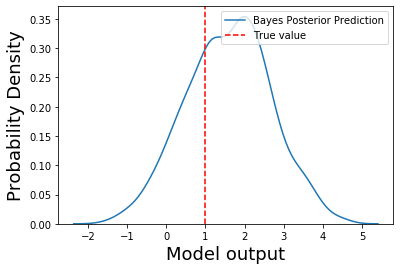

In [25]:
test_id = 1
plot_single_prediction(
    x_test[test_id, :][None, :],
    y_test[test_id].item(),
    hmc_mcmc_predictive
)

### The No-U-Turn Sampler (https://arxiv.org/abs/1111.4246)

In [26]:
nuts_kernel = NUTS(
    model=model,
)

nuts_mcmc_posterior = run_mcmc(
    kernel=nuts_kernel,
    model_args=(x_train, y_train),
    num_samples=num_samples,
    warmup_steps=None,
)

nuts_samples = sample_mcmc(nuts_mcmc_posterior)

Warmup:   0%|                                          | 1/2000 [00:00,  6.42it/s, step size=2.81e-02, acc. prob=1.000]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   0%|                                          | 5/2000 [00:00,  8.43it/s, step size=1.95e-02, acc. prob=0.800]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▎                                        | 13/2000 [00:00, 13.25it/s, step size=1.14e-02, acc. prob=0.787]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   1%|▎                                        | 16/2000 [00:00, 14.67it/s, step size=9.64e-03, acc. prob=0.786]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▍                                        | 20/2000 [00:01, 13.20it/s, step size=3.73e-03, acc. prob=0.772]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▍                                        | 22/2000 [00:01, 11.51it/s, step size=1.14e-02, acc. prob=0.792]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▍                                        | 24/2000 [00:01, 13.00it/s, step size=1.12e-02, acc. prob=0.792]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▌                                        | 26/2000 [00:01, 12.57it/s, step size=4.83e-03, acc. prob=0.781]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   1%|▌                                        | 28/2000 [00:01,  9.75it/s, step size=1.28e-02, acc. prob=0.795]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▌                                        | 30/2000 [00:02,  7.95it/s, step size=2.47e-03, acc. prob=0.775]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▋                                        | 32/2000 [00:02,  5.35it/s, step size=6.91e-03, acc. prob=0.788]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▋                                        | 33/2000 [00:03,  5.38it/s, step size=1.18e-02, acc. prob=0.794]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▋                                        | 35/2000 [00:03,  5.14it/s, step size=3.23e-03, acc. prob=0.780]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▋                                        | 36/2000 [00:03,  5.20it/s, step size=5.44e-03, acc. prob=0.786]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   2%|▊                                        | 37/2000 [00:03,  5.30it/s, step size=9.08e-03, acc. prob=0.792]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▊                                        | 39/2000 [00:04,  6.31it/s, step size=1.84e-03, acc. prob=0.776]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▊                                        | 40/2000 [00:04,  6.11it/s, step size=2.98e-03, acc. prob=0.781]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▊                                        | 41/2000 [00:04,  4.70it/s, step size=4.98e-03, acc. prob=0.787]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▉                                        | 43/2000 [00:04,  5.28it/s, step size=4.75e-03, acc. prob=0.787]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▉                                        | 44/2000 [00:05,  4.38it/s, step size=5.75e-03, acc. prob=0.789]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|▉                                        | 45/2000 [00:05,  4.68it/s, step size=8.90e-03, acc. prob=0.793]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:   2%|▉                                        | 47/2000 [00:05,  5.26it/s, step size=6.18e-03, acc. prob=0.790]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|█                                        | 49/2000 [00:05,  6.26it/s, step size=6.46e-03, acc. prob=0.790]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   2%|█                                        | 50/2000 [00:06,  5.98it/s, step size=1.04e-02, acc. prob=0.795]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█                                        | 52/2000 [00:06,  6.42it/s, step size=9.14e-03, acc. prob=0.794]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█                                        | 54/2000 [00:06,  7.04it/s, step size=9.41e-03, acc. prob=0.794]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▏                                       | 56/2000 [00:06,  7.61it/s, step size=6.72e-03, acc. prob=0.792]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▏                                       | 58/2000 [00:06,  8.45it/s, step size=1.40e-02, acc. prob=0.797]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▏                                       | 60/2000 [00:07,  6.93it/s, step size=4.78e-03, acc. prob=0.789]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▎                                       | 61/2000 [00:07,  6.47it/s, step size=7.34e-03, acc. prob=0.793]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▎                                       | 63/2000 [00:07,  6.82it/s, step size=3.45e-03, acc. prob=0.787]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▎                                       | 64/2000 [00:08,  4.74it/s, step size=5.24e-03, acc. prob=0.790]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   3%|█▎                                       | 67/2000 [00:08,  6.00it/s, step size=2.23e-03, acc. prob=0.785]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   3%|█▍                                       | 68/2000 [00:08,  4.38it/s, step size=3.43e-03, acc. prob=0.788]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   3%|█▍                                       | 69/2000 [00:08,  4.68it/s, step size=5.14e-03, acc. prob=0.791]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▍                                       | 70/2000 [00:09,  4.01it/s, step size=7.83e-03, acc. prob=0.794]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▍                                       | 72/2000 [00:09,  4.76it/s, step size=1.03e-02, acc. prob=0.796]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▌                                       | 74/2000 [00:09,  4.92it/s, step size=6.42e-03, acc. prob=0.793]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▌                                       | 75/2000 [00:10,  5.08it/s, step size=9.24e-03, acc. prob=0.795]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▌                                       | 77/2000 [00:10,  6.38it/s, step size=4.01e-03, acc. prob=0.790]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▌                                       | 78/2000 [00:10,  4.59it/s, step size=6.04e-03, acc. prob=0.793]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▋                                       | 80/2000 [00:10,  5.58it/s, step size=7.41e-03, acc. prob=0.794]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▋                                       | 82/2000 [00:10,  6.63it/s, step size=1.06e-02, acc. prob=0.796]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   4%|█▋                                       | 84/2000 [00:11,  7.64it/s, step size=5.70e-03, acc. prob=0.792]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:   4%|█▊                                       | 88/2000 [00:11,  8.34it/s, step size=1.02e-02, acc. prob=0.796]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:   4%|█▊                                       | 90/2000 [00:11,  8.10it/s, step size=1.11e-02, acc. prob=0.797]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|█▉                                       | 92/2000 [00:12,  7.91it/s, step size=4.76e-03, acc. prob=0.792]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|█▉                                       | 93/2000 [00:12,  6.77it/s, step size=4.15e-03, acc. prob=0.791]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|█▉                                       | 94/2000 [00:12,  6.74it/s, step size=5.48e-03, acc. prob=0.793]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|█▉                                       | 96/2000 [00:12,  5.37it/s, step size=9.03e-03, acc. prob=0.796]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:   5%|██                                       | 99/2000 [00:13,  5.85it/s, step size=5.59e-01, acc. prob=0.792]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██                                      | 102/2000 [00:13,  7.16it/s, step size=1.22e-01, acc. prob=0.778]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   5%|██                                      | 104/2000 [00:13,  6.82it/s, step size=2.18e-01, acc. prob=0.782]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██                                      | 105/2000 [00:14,  6.78it/s, step size=1.27e-01, acc. prob=0.780]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██                                      | 106/2000 [00:14,  6.68it/s, step size=2.13e-01, acc. prob=0.782]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██▏                                     | 107/2000 [00:14,  6.66it/s, step size=3.88e-01, acc. prob=0.784]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   5%|██▏                                     | 109/2000 [00:14,  6.11it/s, step size=1.08e-01, acc. prob=0.781]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:   6%|██▏                                     | 110/2000 [00:15,  4.41it/s, step size=2.03e-01, acc. prob=0.783]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   6%|██▏                                     | 111/2000 [00:15,  4.67it/s, step size=2.24e-01, acc. prob=0.783]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   6%|██▎                                     | 113/2000 [00:15,  5.23it/s, step size=2.00e-01, acc. prob=0.783]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▎                                     | 115/2000 [00:15,  6.67it/s, step size=3.25e-02, acc. prob=0.778]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▎                                     | 116/2000 [00:16,  3.09it/s, step size=6.03e-02, acc. prob=0.780]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▎                                     | 118/2000 [00:16,  3.60it/s, step size=1.93e-01, acc. prob=0.784]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▍                                     | 119/2000 [00:17,  4.17it/s, step size=3.59e-01, acc. prob=0.785]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▍                                     | 121/2000 [00:17,  5.41it/s, step size=4.75e-01, acc. prob=0.786]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▍                                     | 123/2000 [00:17,  4.33it/s, step size=8.78e-02, acc. prob=0.782]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▍                                     | 124/2000 [00:18,  4.01it/s, step size=1.57e-01, acc. prob=0.783]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▌                                     | 125/2000 [00:18,  4.50it/s, step size=2.84e-01, acc. prob=0.785]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▌                                     | 127/2000 [00:18,  5.47it/s, step size=3.32e-01, acc. prob=0.786]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   6%|██▌                                     | 130/2000 [00:18,  6.53it/s, step size=1.15e-01, acc. prob=0.783]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▌                                     | 131/2000 [00:18,  6.60it/s, step size=2.03e-01, acc. prob=0.784]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 133/2000 [00:18,  7.76it/s, step size=3.54e-01, acc. prob=0.786]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 135/2000 [00:19,  4.83it/s, step size=8.04e-02, acc. prob=0.782]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▋                                     | 136/2000 [00:19,  5.02it/s, step size=1.37e-01, acc. prob=0.783]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   7%|██▋                                     | 137/2000 [00:20,  5.21it/s, step size=2.01e-01, acc. prob=0.785]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▊                                     | 139/2000 [00:20,  5.75it/s, step size=2.93e-01, acc. prob=0.786]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▊                                     | 141/2000 [00:20,  6.17it/s, step size=8.27e-02, acc. prob=0.782]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

Warmup:   7%|██▊                                     | 142/2000 [00:21,  3.97it/s, step size=1.35e-01, acc. prob=0.784]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▊                                     | 143/2000 [00:21,  3.08it/s, step size=2.22e-01, acc. prob=0.785]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 144/2000 [00:22,  2.61it/s, step size=3.38e-01, acc. prob=0.786]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 145/2000 [00:22,  2.99it/s, step size=5.24e-02, acc. prob=0.781]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 146/2000 [00:23,  1.99it/s, step size=8.73e-02, acc. prob=0.783]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   7%|██▉                                     | 147/2000 [00:23,  2.27it/s, step size=1.44e-01, acc. prob=0.784]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 148/2000 [00:24,  2.04it/s, step size=2.36e-01, acc. prob=0.785]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   7%|██▉                                     | 149/2000 [00:24,  2.38it/s, step size=3.79e-01, acc. prob=0.785]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 151/2000 [00:24,  3.21it/s, step size=1.08e-01, acc. prob=0.775]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 152/2000 [00:25,  2.36it/s, step size=1.09e-01, acc. prob=0.776]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 153/2000 [00:25,  2.83it/s, step size=1.10e-01, acc. prob=0.777]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 155/2000 [00:25,  3.26it/s, step size=2.46e-01, acc. prob=0.780]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███                                     | 156/2000 [00:26,  3.07it/s, step size=3.10e-02, acc. prob=0.776]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 157/2000 [00:27,  1.51it/s, step size=5.55e-02, acc. prob=0.777]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 158/2000 [00:28,  1.41it/s, step size=9.61e-02, acc. prob=0.778]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 159/2000 [00:29,  1.35it/s, step size=1.44e-01, acc. prob=0.779]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 160/2000 [00:29,  1.57it/s, step size=2.54e-01, acc. prob=0.781]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▏                                    | 162/2000 [00:29,  2.05it/s, step size=3.83e-01, acc. prob=0.782]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▎                                    | 165/2000 [00:30,  3.18it/s, step size=4.71e-01, acc. prob=0.782]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▎                                    | 167/2000 [00:31,  2.54it/s, step size=7.64e-02, acc. prob=0.779]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▎                                    | 168/2000 [00:32,  1.45it/s, step size=1.40e-01, acc. prob=0.780]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   8%|███▍                                    | 169/2000 [00:33,  1.61it/s, step size=2.43e-01, acc. prob=0.781]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▍                                    | 171/2000 [00:33,  2.15it/s, step size=3.23e-01, acc. prob=0.782]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▍                                    | 172/2000 [00:33,  2.73it/s, step size=3.37e-02, acc. prob=0.777]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▍                                    | 173/2000 [00:35,  1.54it/s, step size=6.24e-02, acc. prob=0.779]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▍                                    | 174/2000 [00:35,  1.60it/s, step size=1.14e-01, acc. prob=0.780]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 175/2000 [00:35,  2.06it/s, step size=2.06e-01, acc. prob=0.781]


tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  

Warmup:   9%|███▌                                    | 177/2000 [00:36,  2.72it/s, step size=1.98e-01, acc. prob=0.781]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 178/2000 [00:36,  3.18it/s, step size=3.31e-01, acc. prob=0.782]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

Warmup:   9%|███▌                                    | 179/2000 [00:36,  3.72it/s, step size=5.03e-02, acc. prob=0.779]

tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0.0000],
        [ 0.0468, -0.0316,  2.0000,  ..., -0.5235, -0.4906,  0.0000],
        ...,
        [-1.1053, -0.6900,  5.0000,  ..., -0.5235, -1.0864,  0.0000],
        [ 1.1103,  0.6268,  4.0000,  ...,  0.5581,  1.0817,  1.0000],
        [ 0.1354, -0.0316,  3.0000,  ...,  0.0173, -0.5072,  1.0000]])
tensor([[-0.4849, -0.5254,  3.0000,  ...,  0.0173, -0.7389,  1.0000],
        [-1.6370, -2.5004,  1.0000,  ..., -1.6052, -1.1526,  0

KeyboardInterrupt: 

In [ ]:
nuts_mcmc_posterior.summary()

In [ ]:
nuts_mcmc_predictive = Predictive(
    model,
    posterior_samples=nuts_samples,
    return_sites=('obs','_RETURN')
)
nuts_mcmc_predictive(x_test)

In [ ]:
properties = {
    'x': 0,
    'x_label': "GRE Score",
    'y_label': "Chance of Admit",
    'category': 6,
    'category_labels': {
        0: "No exp. in research",
        1: "Exp. in research",
    }
}
predictors = {
    'HMC-MCMC': hmc_mcmc_predictive,
    'NUTS-MCMC': nuts_mcmc_predictive,
}
data = {
    'x': x_test,
    'y': y_test
}
plot_predictions(data, predictors, properties)

# Variational Inference estimation


In [27]:
display_sourcecode(model)

def model(x, y=None):
    print(x)
    intercept = pyro.sample("intercept", dist.Normal(beta[0], 10))
    b_GRE = pyro.sample("b_GRE", dist.Normal(beta[1], 1))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(beta[2], 1))
    b_university = pyro.sample("b_university", dist.Normal(beta[3], 1))
    b_SOP = pyro.sample("b_SOP", dist.Normal(beta[4], 1))
    b_LOP = pyro.sample("b_LOP", dist.Normal(beta[5], 1))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(beta[6], 1))
    b_research = pyro.sample("b_research", dist.Normal(beta[7], 1))

    sigma = pyro.sample("sigma", dist.Exponential(1))
    
    mean = (
            intercept +
            b_GRE * x[:, 0] +
            b_TEOFL * x[:, 1] +
            b_university * x[:, 2] +
            b_SOP * x[:, 3] +
            b_LOP * x[:, 4] +
            b_CGPA * x[:, 5] +
            b_research * x[:, 6]
    )
    with pyro.plate("data", x.shape[0]):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
    return mean

In [28]:
def guide(x, y=None):
    loc = pyro.param('loc', torch.randn(8))
    scale = pyro.param('scale', torch.ones(8),
                               constraint=constraints.positive)
    b_GRE = pyro.sample("b_GRE", dist.Normal(loc[0], scale[0]))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(loc[1], scale[1]))
    b_university = pyro.sample("b_university", dist.Normal(loc[2], scale[2]))
    b_SOP = pyro.sample("b_SOP", dist.Normal(loc[3], scale[3]))
    b_LOP = pyro.sample("b_LOP", dist.Normal(loc[4], scale[4]))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(loc[5], scale[5]))
    b_research = pyro.sample("b_research", dist.Normal(loc[6], scale[6]))
    intercept = pyro.sample("intercept", dist.Normal(loc[7], scale[7]))

    sigma_mean = pyro.param(
        'sigma_mean',
        torch.ones(1),
        constraint=constraints.positive
    )
    sigma = pyro.sample("sigma", dist.Normal(sigma_mean, torch.Tensor([0.05])))

In [ ]:
elbos, params = run_svi(model, guide, x_train, y_train)

In [ ]:
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

In [ ]:
svi_param_store = dict(pyro.get_param_store())
for name, value in svi_param_store.items():
    print(name, value.detach().cpu())

In [ ]:
display_sourcecode(SviPredictive)

In [ ]:
svi_predictive = SviPredictive(
    model,
    guide=guide,
    num_samples=num_samples,
    return_sites=('obs','_RETURN')
)
svi_predictive(x_test)

In [ ]:
properties = {
    'x': 0,
    'x_label': "GRE Score",
    'y_label': "Chance of Admit",
    'category': 6,
    'category_labels': {
        0: "No exp. in research",
        1: "Exp. in research",
    }
}
predictors = {
    'HMC-MCMC': hmc_mcmc_predictive,
    'NUTS-MCMC': nuts_mcmc_predictive,
    'SVI': svi_predictive
}
data = {
    'x': x_test,
    'y': y_test
}
plot_predictions(data, predictors, properties)

In [ ]:
display_sourcecode(sample_svi)

In [ ]:
svi_samples = sample_svi(
    model,
    guide,
    num_samples,
    x_test
)

In [ ]:
print_summary(summary(svi_samples))

In [ ]:
sites = [
    "intercept",
    "b_GRE",
    "b_TEOFL",
    "b_university",
    "b_SOP",
    "b_LOP",
    "b_CGPA",
    "b_research",
    "sigma"
]

sites_dist = {
    "intercept": norm(
        loc=svi_param_store['loc'].detach()[7].item(),
        scale=svi_param_store['scale'].detach()[7].item()
    ),
    "b_GRE": norm(
        loc=svi_param_store['loc'].detach()[0].item(),
        scale=svi_param_store['scale'].detach()[0].item()
    ),
    "b_TEOFL": norm(
        loc=svi_param_store['loc'].detach()[1].item(),
        scale=svi_param_store['scale'].detach()[1].item()
    ),
    "b_university": norm(
        loc=svi_param_store['loc'].detach()[2].item(),
        scale=svi_param_store['scale'].detach()[2].item()
    ), 
    "b_SOP": norm(
        loc=svi_param_store['loc'].detach()[3].item(),
        scale=svi_param_store['scale'].detach()[3].item()
    ),
    "b_LOP": norm(
        loc=svi_param_store['loc'].detach()[4].item(),
        scale=svi_param_store['scale'].detach()[4].item()
    ),
    "b_CGPA": norm(
        loc=svi_param_store['loc'].detach()[5].item(),
        scale=svi_param_store['scale'].detach()[5].item()
    ),
    "b_research": norm(
        loc=svi_param_store['loc'].detach()[6].item(),
        scale=svi_param_store['scale'].detach()[6].item()
    ),
    'sigma': norm(
        loc=svi_param_store['sigma_mean'].detach().item(),
        scale=0.05
    ),
}

samples = {
#     "HMC": hmc_samples,
    "NUTS": nuts_samples,
}

plot_mpd(sites, sites_dist, samples, svi_samples)

In [ ]:
interactive_plot = interact_manual(
    make_interavtive,
    nd=IntSlider(min=10, max=len(y_train), step=5, value=30),
    ns=fixed(num_samples),
    data=fixed({
        'x_train': x_train,
        'y_train': y_train,
        'x_test': x_test,
        'y_test': y_test,
        }),
    samples=fixed(samples),
    model=fixed(model),
    guide=fixed(guide),
    sites=fixed(sites)
    )
interactive_plot;

# I don't like the way we've handled `sigma`. Can we do something different?
Use Dirac Delta in the guide. It's implement as distribution in pyro - [Delta](http://docs.pyro.ai/en/stable/distributions.html#delta)

In [ ]:
display_sourcecode(model)

In [ ]:
def guide(x, y=None):
    loc = pyro.param('loc', torch.randn(8))
    scale = pyro.param('scale', torch.ones(8),
                               constraint=constraints.positive)
    b_GRE = pyro.sample("b_GRE", dist.Normal(loc[0], scale[0]))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(loc[1], scale[1]))
    b_university = pyro.sample("b_university", dist.Normal(loc[2], scale[2]))
    b_SOP = pyro.sample("b_SOP", dist.Normal(loc[3], scale[3]))
    b_LOP = pyro.sample("b_LOP", dist.Normal(loc[4], scale[4]))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(loc[5], scale[5]))
    b_research = pyro.sample("b_research", dist.Normal(loc[6], scale[6]))
    intercept = pyro.sample("intercept", dist.Normal(loc[7], scale[7]))

    sigma_loc = pyro.param("drift_loc", lambda: torch.tensor(1.),
                           constraint=constraints.positive)
    pyro.sample("sigma", dist.Delta(sigma_loc))

In [ ]:
elbos, params = run_svi(model, guide, x_train, y_train)
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

# Can I obtain in writting less code?
Yes, you can use [EasyGuide](http://docs.pyro.ai/en/stable/contrib.easyguide.html) 

In [ ]:
from pyro.contrib.easyguide import easy_guide

In [ ]:
@easy_guide(model)
def guide(self, x, y=None):
    loc = pyro.param('loc', torch.randn(8))
    scale = pyro.param('scale', torch.ones(8),
                               constraint=constraints.positive)
    b_GRE = pyro.sample("b_GRE", dist.Normal(loc[0], scale[0]))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(loc[1], scale[1]))
    b_university = pyro.sample("b_university", dist.Normal(loc[2], scale[2]))
    b_SOP = pyro.sample("b_SOP", dist.Normal(loc[3], scale[3]))
    b_LOP = pyro.sample("b_LOP", dist.Normal(loc[4], scale[4]))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(loc[5], scale[5]))
    b_research = pyro.sample("b_research", dist.Normal(loc[6], scale[6]))
    intercept = pyro.sample("intercept", dist.Normal(loc[7], scale[7]))

    self.map_estimate("sigma")

In [ ]:
elbos, params = run_svi(model, guide, x_train, y_train)
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

Also check out the [Group](http://docs.pyro.ai/en/stable/contrib.easyguide.html#group) class and [how to use it with `EasyGuide`](https://pyro.ai/examples/easyguide.html#Using-EasyGuide).

# And maybe can I use some non-probabilistic models/modules within my probabilistic model and train the parameters simultanously?
Yes, as long as they are `torch` modules

In [ ]:
def model(x, y=None):
    # summarize all the student's scores (GRE, TEOFL, SOP, LOP, CGPA) with 2 dimensions
    dimensionality_reduction = nn.Linear(5, 2)
    pyro.module('dimensionality_reduction', dimensionality_reduction)  
    x_score = dimensionality_reduction(x[:, [0, 1, 3, 4, 5]])

    intercept = pyro.sample("intercept", dist.Normal(0, 10))
    b_university = pyro.sample("b_university", dist.Normal(0, 1))
    b_research = pyro.sample("b_research", dist.Normal(0, 1))
    b_score1 = pyro.sample("b_score1", dist.Normal(0, 1))
    b_score2 = pyro.sample("b_score2", dist.Normal(0, 1))

    sigma = pyro.sample("sigma", dist.Exponential(1))
    
    mean = (
            intercept +
            b_university * x[:, 2] +
            b_research * x[:, 6] +
            b_score1 * x_score[:, 0] +
            b_score2 * x_score[:, 1]
    )
    with pyro.plate("data", x.shape[0]):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
    return mean

In [ ]:
@easy_guide(model) # pyro.module can be used without EasyGuide
def guide(self, x, y=None):
    loc = pyro.param('loc', torch.randn(5))
    scale = pyro.param('scale', torch.ones(5),
                               constraint=constraints.positive)
    b_university = pyro.sample("b_university", dist.Normal(loc[0], scale[0]))
    b_research = pyro.sample("b_research", dist.Normal(loc[1], scale[1]))
    intercept = pyro.sample("intercept", dist.Normal(loc[2], scale[2]))
    b_score1 = pyro.sample("b_score1", dist.Normal(loc[3], scale[3]))
    b_score2 = pyro.sample("b_score2", dist.Normal(loc[4], scale[4]))

    self.map_estimate("sigma")

In [ ]:
elbos, params = run_svi(model, guide, x_train, y_train, loss=TraceGraph_ELBO())
print(dict(pyro.get_param_store()))
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().reshape(-1).numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

Anybody has noted another difference? The default loss, which was `Trace_ELBO()`, has been replaced with `TraceGraph_ELBO()`. Adding non-probabilist parts is something else from the perspective of `ELBO` and `SVI` to the models we have seen before. We need to track the whole computational `Graph` and that is what `TraceGraph_ELBO()` id doing. We will elaborate on losses implemented in `pyro` later on.

# Do I have to use `torch.nn.Module` to optimize a single parameter?
No, you can use [`pyro.deterministic`](http://docs.pyro.ai/en/stable/primitives.html#pyro.primitives.deterministic) for that purpose (and for much more!)

There is suspicion that universities were overrated. Let's decrease their rates. Estimate to what extend.

In [ ]:
def model(x, y=None):
    decrease = pyro.param(
        'decrease',
        torch.Tensor([3]),
        constraint=constraints.interval(1, 5)
    )
    
    uni = pyro.deterministic('uni', torch.clamp(x[:, 2] - decrease, min=0.)) # the operation has to track gradient!
    
    intercept = pyro.sample("intercept", dist.Normal(0, 10))
    b_GRE = pyro.sample("b_GRE", dist.Normal(0, 1))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(0, 1))
    b_university = pyro.sample("b_university", dist.Normal(0, 1))
    b_SOP = pyro.sample("b_SOP", dist.Normal(0, 1))
    b_LOP = pyro.sample("b_LOP", dist.Normal(0, 1))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(0, 1))
    b_research = pyro.sample("b_research", dist.Normal(0, 1))

    sigma = pyro.sample("sigma", dist.Exponential(1))
    
    mean = (
            intercept +
            b_GRE * x[:, 0] +
            b_TEOFL * x[:, 1] +
            b_university * uni +
            b_SOP * x[:, 3] +
            b_LOP * x[:, 4] +
            b_CGPA * x[:, 5] +
            b_research * x[:, 6]
    )
    with pyro.plate("data", x.shape[0]):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
    return mean

In [ ]:
def guide(x, y=None):  
    loc = pyro.param('loc', torch.randn(8))
    scale = pyro.param('scale', torch.ones(8),
                               constraint=constraints.positive)
    b_GRE = pyro.sample("b_GRE", dist.Normal(loc[0], scale[0]))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(loc[1], scale[1]))
    b_university = pyro.sample("b_university", dist.Normal(loc[2], scale[2]))
    b_SOP = pyro.sample("b_SOP", dist.Normal(loc[3], scale[3]))
    b_LOP = pyro.sample("b_LOP", dist.Normal(loc[4], scale[4]))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(loc[5], scale[5]))
    b_research = pyro.sample("b_research", dist.Normal(loc[6], scale[6]))
    intercept = pyro.sample("intercept", dist.Normal(loc[7], scale[7]))

    sigma_loc = pyro.param("drift_loc", lambda: torch.tensor(1.),
                           constraint=constraints.positive)
    pyro.sample("sigma", dist.Delta(sigma_loc))

In [ ]:
elbos, params = run_svi(model, guide, x_train, y_train)
print(dict(pyro.get_param_store()))
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().reshape(-1).numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

Remarks:
- `TraceGraph_ELBO` was not needed here, but be carefull
- `pyro.deterministic` can be invoked in the `guide`
- when a value returned by `pyro.detereministic` is passed to sample other sites, then we need (or are really likely to want) to perform the operation in the guide. Then we perfom the operation without wrapping it with `pyro.detereministic`

Are you familiar with the avialible constraints? You can check them [here](http://docs.pyro.ai/en/stable/_modules/torch/distributions/constraints.html)

# Can we vectorize it?

# And why not to use Class?

In [ ]:
class BayesianLinearRegression(nn.Module):
    
    def __init__(self, n_input, intercept=True):
        super().__init__()
        self.n_input = n_input
        self.has_intercept = intercept
        
    def model(self, x, y=None):
        if self.has_intercept:
            intercept = pyro.sample(
                'intercept',
                dist.Normal(0., 10.).expand([1]).to_event(1)
            )
        else:
            intercept = torch.Tensor([0.])
        coefficients = pyro.sample(
            'coefficients',
            dist.Normal(0., 1.).expand([1, self.n_input]).to_event(2)
        )
        sigma = pyro.sample("sigma", dist.Uniform(0., 10.))
        mean = coefficients @ x.t() + intercept
        with pyro.plate("data", x.shape[0]):
            print(y)
            obs = pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
        return mean
    
    def forward(self, *args, **kwargs):
        return self.model(*args, **kwargs)
    
    def guide(self, x, y=None):
        sigma_loc = pyro.param(
            'sigma_loc',
            torch.rand(1),
            constraint=constraints.positive
        )
        loc = pyro.param(
            'loc',
            torch.zeros([1, self.n_input])
        )
        scale = pyro.param(
            'scale',
            torch.ones([1, self.n_input]),
            constraint=constraints.positive
        )
        if self.has_intercept:
            intercept_loc = pyro.param('intercept_loc', torch.zeros(1))
            intercept_scale = pyro.param(
                'intercept_scale',
                torch.ones(1),
                constraint=constraints.positive
            )
            pyro.sample(
                'intercept',
                dist.Normal(intercept_loc, intercept_scale).to_event(1)
            )
        
        pyro.sample('coefficients', dist.Normal(loc, scale).to_event(2))
        pyro.sample('sigma', dist.Normal(sigma_loc, torch.Tensor([0.05])))

m = BayesianLinearRegression(7, True)

adam = pyro.optim.Adam({"lr": 0.03})
elbos, params = run_svi(m, m.guide, x_train, y_train, adam)

print(dict(pyro.get_param_store()))

What is `to_event()`? Check [documentation of `TorchDistribution` (paragraph about Tensor Shapes)](http://docs.pyro.ai/en/stable/distributions.html#torchdistribution) and the [Tutorial on Tensor shapes in Pyro](https://pyro.ai/examples/tensor_shapes.html)

Remarks:
- `pyro.param` can take argument `event_dim` which has the same meaning as `to_event()` for distribtuions.

# But can I initialize stuff in the constructor?
Yes - use [`PyroModule`](http://docs.pyro.ai/en/stable/nn.html#pyro.nn.module.PyroModule)

In [ ]:
from pyro.nn import PyroModule, PyroSample

In [ ]:
class BayesianLinearRegression(PyroModule):
    
    def __init__(self, n_input, intercept=True):
        super().__init__()
        self.linear = PyroModule()
        self.linear.coefficients = PyroSample(
            dist.Normal(0., 1.).expand([1, n_input]).to_event(2)
        )
        if intercept:
            self.linear.intercept = PyroSample(
                dist.Normal(0., 10.).expand([1]).to_event(1)
            )
        else:
            self.linear.intercept = torch.Tensor([0.])
        self.n_input = n_input
        self.has_intercept = intercept
        
    def model(self, x, y=None):
        sigma = pyro.sample("sigma", dist.Uniform(0., 10.))
        mean = self.linear.coefficients @ x.t() + self.linear.intercept
        with pyro.plate("data", x.shape[0]):
            obs = pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
        return mean
    
    def forward(self, *args, **kwargs):
        return self.model(*args, **kwargs)

# But do I have to implement the `forward` method for each type of module?
No! Inherit it from [`torch.nn` modules](https://pytorch.org/docs/stable/nn.html).
Here we will use [`torch.nn.Linear`](https://pytorch.org/docs/stable/nn.html#linear).

In [ ]:
class BayesianLinearRegression(PyroModule):
    
    def __init__(self, n_input, intercept=True):
        super().__init__()
        self.linear = PyroModule[nn.Linear](n_input, 1, intercept)
        self.linear.weight = PyroSample(
            dist.Normal(0., 1.).expand([1, n_input]).to_event(2)
        )
        if intercept:
            self.linear.bias = PyroSample(
                dist.Normal(0., 10.).expand([1]).to_event(1)
            )
        self.n_input = n_input
        self.has_intercept = intercept
        
    def model(self, x, y=None):
        sigma = pyro.sample("sigma", dist.Uniform(0., 10.))
        mean = self.linear(x).squeeze(-1)
        with pyro.plate("data", x.shape[0]):
            obs = pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
        return mean
    
    def forward(self, *args, **kwargs):
        return self.model(*args, **kwargs)

# But how to write guides for such models? Sites have no names.
Use [AutoGuide](http://docs.pyro.ai/en/stable/infer.autoguide.html)

In [ ]:
from pyro.infer.autoguide import AutoDiagonalNormal

In [ ]:
class BayesianLinearRegression(PyroModule):
    
    def __init__(self, n_input, intercept=True):
        super().__init__()
        self.linear = PyroModule[nn.Linear](n_input, 1, intercept)
        self.linear.weight = PyroSample(
            dist.Normal(0., 1.).expand([1, n_input]).to_event(2)
        )
        if intercept:
            self.linear.bias = PyroSample(
                dist.Normal(0., 10.).expand([1]).to_event(1)
            )
        self.n_input = n_input
        self.has_intercept = intercept
        
    def model(self, x, y=None):
        sigma = pyro.sample("sigma", dist.Uniform(0., 10.))
        mean = self.linear(x).squeeze(-1)
        with pyro.plate("data", x.shape[0]):
            obs = pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
        return mean
    
    def forward(self, *args, **kwargs):
        return self.model(*args, **kwargs)

m = BayesianLinearRegression(7, False)
guide = AutoDiagonalNormal(m)

adam = pyro.optim.Adam({"lr": 0.03})
elbos, params = run_svi(m, guide, x_train, y_train, adam)


print(dict(pyro.get_param_store()))

`AutoGuide` can be used with any model.

If you use `AutoGuide` you can detach params with a single command

In [ ]:
guide.requires_grad_(False)
print(dict(pyro.get_param_store()))

You can investigate the distribution of params by calling the `quantiles()` method of `guide`.

In [ ]:
guide.quantiles([0.25, 0.5, 0.75])

### How about more sofisticated guides than those in `pyro.infer.autoguide`?

In [ ]:
display_sourcecode(pyro.infer.autoguide)

You can use [`AutoGuideList`](http://docs.pyro.ai/en/stable/infer.autoguide.html#autoguidelist) with [`poutine.block` primitive](http://docs.pyro.ai/en/stable/poutine.html#pyro.poutine.handlers.block) to use the avialible `AutoGuide`s as building blocks.

# What else can be helpfull in the world of `pyro`?

#### [`ParamStore` class](http://docs.pyro.ai/en/stable/parameters.html)
Gives convenient access to param_store.

#### [`to_pyro_module_` function](http://docs.pyro.ai/en/stable/nn.html#pyro.nn.module.to_pyro_module_)
Converts an ordinary `torch.nn.Module` instance to a `PyroModule` in-place.

Priors need to be set manually.

In [ ]:
from pyro.nn.module import to_pyro_module_, PyroModule, PyroSample

In [ ]:
model = nn.Sequential(
    nn.Linear(28 * 28, 100),
    nn.Sigmoid(),
    nn.Linear(100, 100),
    nn.Sigmoid(),
    nn.Linear(100, 10),
)
to_pyro_module_(model)

for m in model.modules():
    for name, value in list(m.named_parameters(recurse=False)):
        setattr(m, name, PyroSample(prior=dist.Normal(0, 1)
                                              .expand(value.shape)
                                              .to_event(value.dim())))
guide = AutoDiagonalNormal(model)

# Is there anything more to explore in `pyro.infer`?

## Inference methods/models

### SVI with [ELBO](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.elbo)

There is much more to be done with ELBO than `Trace_ELBO` and `TraceGraphELBO`! Choose your ELBO wisely.

### Estimation with [Importance Sampling](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.importance)
Mind that `guide` has differt meaning than in SVI.

### [Reweighted Wake-Sleep](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.rws)
Check out [the paper](https://arxiv.org/pdf/1406.2751.pdf) for details.

Mind that `guide` (probably) has differt meaning than in SVI.

### [Sequential Monte Carlo](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.smcfilter)
Check out [a short document (142 pages)](http://hedibert.org/wp-content/uploads/2013/12/UPCcourse-handouts.pdf) (published as course material for [Markov Chain Monte Carlo and Sequential Monte Carlo Methods
in Dynamic Models and Stochastic Volatility Models Tutorial](http://hedibert.org/markov-chain-monte-carlo-and-sequential-monte-carlo-methods-in-dynamic-models-and-stochastic-volatility-models/) by [Prof. Hedibert Freitas Lopes](http://hedibert.org/)) relating SMC with MCMC

Mind that `guide` has differt meaning than in SVI.

### [Stein Methods](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.svgd)
Check out [the paper](https://arxiv.org/pdf/1608.04471.pdf) for details.

Models have to be fully vectorized and may only contain continuous latent variables.

The `guide` is replaced by `kernel`.

### [Energy Statistics](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.energy_distance)
Check out [the paper](https://www.sciencedirect.com/science/article/pii/S0378375813000633) for details.

A "Likelihood free" method.

### [Inference for discrete sites](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.discrete)
Examples of using `TraceEnumSample_ELBO`, `@infer_discrete` decorator and `@config_enumerate` decorator.

## [Inference Utilities](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.predictive)

Such as:
- `Predictive`
- `EmpiricalMarginal` - Marginal distribution over a single site
and more

## [Reparameterizers](http://docs.pyro.ai/en/stable/infer.reparam.html#module-pyro.infer.reparam)
*Reparameterising a probabilistic model means expressing it in terms of new variables defined by abijective transformation of the original variables of interest. The reparameterised model expressesthe same statistical assumptions as the original, but can have drastically different posterior geometry,with significant implications for both variational and sampling-based inference algorithms.*

For more details check [the paper](https://arxiv.org/pdf/1906.03028.pdf).

Contains utilities such as `ConjugateReparam` wich alows to implement conjugate posterior to be applied with data.

To use it, call [`pyro.poutine.reparam'](http://docs.pyro.ai/en/stable/poutine.html#pyro.poutine.handlers.reparam)

In [ ]:
torch.Tensor(3)